<a href="https://colab.research.google.com/github/raoofzare/CGAN/blob/main/CGAN_PROP.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from __future__ import print_function
#%matplotlib inline
import random
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision import datasets # Training dataset
from torchvision.utils import make_grid
from torchvision import utils
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt

import numpy as np

import matplotlib.animation as animation
from IPython.display import HTML


# Decide which device we want to run on
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print("My device: => ", device)

# Set random seed for reproducibility
my_seed = 123
random.seed(my_seed)
torch.manual_seed(my_seed);

My device: =>  cuda:0


In [ ]:
batch_size = 128

data_train = datasets.FashionMNIST('./data', download=True, train=True, transform=transforms.Compose([transforms.ToTensor()]))
train_loader = DataLoader(data_train, batch_size=batch_size, shuffle=True)

  0%|          | 0/26421880 [00:00<?, ?it/s]

Extracting ./data/FashionMNIST/raw/train-images-idx3-ubyte.gz to ./data/FashionMNIST/raw



  0%|          | 0/29515 [00:00<?, ?it/s]

Extracting ./data/FashionMNIST/raw/train-labels-idx1-ubyte.gz to ./data/FashionMNIST/raw



  0%|          | 0/4422102 [00:00<?, ?it/s]

Extracting ./data/FashionMNIST/raw/t10k-images-idx3-ubyte.gz to ./data/FashionMNIST/raw



  0%|          | 0/5148 [00:00<?, ?it/s]

Extracting ./data/FashionMNIST/raw/t10k-labels-idx1-ubyte.gz to ./data/FashionMNIST/raw



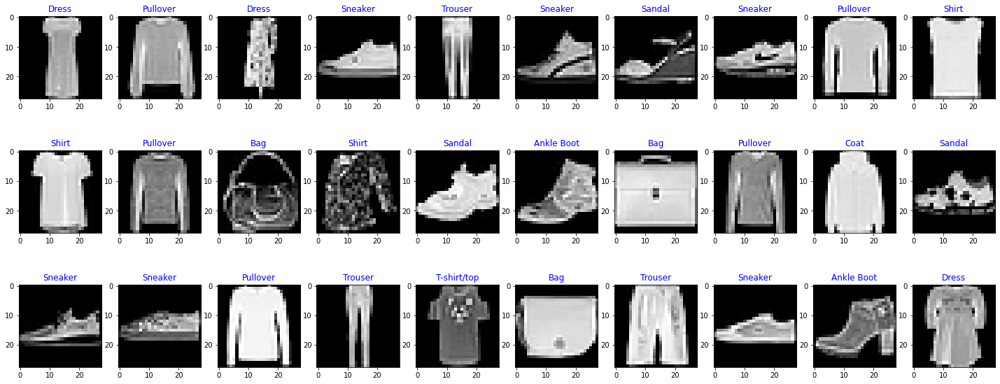

In [ ]:
classes = ['T-shirt/top','Trouser','Pullover','Dress','Coat','Sandal','Shirt','Sneaker','Bag','Ankle Boot']

dataiter = iter(train_loader)
images, labels = dataiter.next()
images_arr = []
labels_arr = []

for i in range(0, 30):
  images_arr.append(images[i].unsqueeze(0))
  labels_arr.append(labels[i].item())

fig = plt.figure(figsize=(25, 10))
for i in range(30):
  ax = fig. add_subplot(3, 10, i+1)
  ax.imshow(images_arr[i].resize_(1, 28, 28).numpy().squeeze(), cmap='gray')
  ax.set_title(f"{classes[labels_arr[i]]}", color=("blue"))


In [ ]:
def linear_generator_block(input_dim, output_dim):
  simple_net = nn.Sequential(
      nn.Linear(input_dim, output_dim),
      nn.BatchNorm1d(output_dim),
      nn.LeakyReLU(negative_slope=0.01, inplace=False),
      nn.Dropout(0.1),
  )
  return simple_net

In [ ]:
class Generator(nn.Module):
  def __init__(self, noise_dim=10, img_dim=28*28, hidden_dim=128, embedding_dimension=10):
    super(Generator, self).__init__()

    self.embedding_dimension = embedding_dimension
    self.embedding = nn.Embedding(10, embedding_dimension)

    self.gen = nn.Sequential(
        linear_generator_block(noise_dim + self.embedding_dimension, hidden_dim),
        linear_generator_block(hidden_dim, hidden_dim * 2),
        linear_generator_block(hidden_dim * 2, hidden_dim * 4),
        linear_generator_block(hidden_dim * 4, hidden_dim * 8),
        nn.Linear(hidden_dim * 8, img_dim),
        nn.Sigmoid()
    )

  def forward(self, noise, labels):
    embedding = self.embedding(labels)
    gen_input = torch.cat([noise, embedding], 1)
    gen_output = self.gen(gen_input)
    return gen_output
      

In [ ]:
# Generate Noise:

def get_generator_noise(n_sample, noise_dim, device='cpu'):
  my_noise = torch.randn(n_sample, noise_dim, device=device)
  return my_noise

In [ ]:
# Discriminator Block

def linear_discriminator_block(input_dim, output_dim):
  simple_net = nn.Sequential(
      nn.Linear(input_dim, output_dim),
      nn.LeakyReLU(negative_slope=0.01, inplace=False)
  )
  return simple_net

def linear_discriminator_block_complicated(input_dim, output_dim):
  simple_net = nn.Sequential(
      nn.Linear(input_dim, output_dim),
      nn.BatchNorm1d(output_dim),
      nn.LeakyReLU(negative_slope=0.01, inplace=False),
      nn.Dropout(0.1)
  )
  
  return simple_net

In [ ]:
# Discriminator Class:

class Discriminator(nn.Module):
  def __init__(self, img_dim=28*28, hidden_dim=128, embedding_dimension=10):
    super(Discriminator, self).__init__()

    self.embedding_dimension = embedding_dimension
    self.embedding = nn.Embedding(10, embedding_dimension)

    self.disc = nn.Sequential(
        linear_discriminator_block(img_dim + self.embedding_dimension, hidden_dim * 4),
        linear_discriminator_block(hidden_dim * 4, hidden_dim * 2),
        linear_discriminator_block(hidden_dim * 2, hidden_dim),
        nn.Linear(hidden_dim, 1),
        nn.Sigmoid()
    )

  def forward(self, image, labels):
    embedding = self.embedding(labels)
    disc_input = torch.cat([image, embedding], 1)
    disc_output = self.disc(disc_input)
    return disc_output


In [ ]:
# Set parameters
batch_size = 128
criterion = nn.BCEWithLogitsLoss()
num_epochs = 130
noise_dim = 64
display_step = 100
lr = 0.0001

image_size = (1, 28, 28)

device = 'cuda'

In [ ]:
# Generator:
fake_labels = torch.randint(0, 10, (batch_size,)).to(device)
generator = Generator(noise_dim).to(device)
gen_optimizer = torch.optim.Adam(generator.parameters(), lr=lr)

# Discriminator:
discriminator = Discriminator().to(device)
disc_optimizer = torch.optim.Adam(discriminator.parameters(), lr=lr)

In [ ]:
# Generator Loss:
def get_generator_loss(generator, discriminator, criterion, num_images, noise_dim, fake_labels, device):
  noise = get_generator_noise(num_images, noise_dim, device=device)
  gen_output = generator(noise, fake_labels)
  disc_preds = discriminator(gen_output, fake_labels) # gen_output.detach()
  gen_loss = criterion(disc_preds, torch.ones_like(disc_preds))

  return gen_loss

In [ ]:
# Discriminator Loss:

def get_discriminator_loss(generator, discriminator, criterion, real_images, num_images, noise_dim, true_labels, device):
  fake_labels = torch.randint(0, 10, (num_images,)).to(device)
  noise = get_generator_noise(num_images, noise_dim, device=device)
  gen_output = generator(noise, fake_labels)
  disc_out_fake = discriminator(gen_output.detach(), fake_labels)
  disc_loss_fake = criterion(disc_out_fake, torch.zeros_like(disc_out_fake))
  disc_out_real = discriminator(real_images, true_labels)
  disc_loss_real = criterion(disc_out_real, torch.ones_like(disc_out_real))

  disc_loss = (disc_loss_fake + disc_loss_real) / 2
  return disc_loss

In [ ]:
# Show Images Function:

def show_tensor_images(real, fake, num_images=25, size=(1, 28, 28)):
  plt.figure(figsize=(15,15))
  image_unflat_real = real.detach().cpu().view(-1, *size)
  image_grid_real = make_grid(image_unflat_real[:num_images], nrow=5, normalize=True, padding=2)
  plt.subplot(1,2,1)
  plt.axis("off")
  plt.title("Real Images")
  plt.imshow(image_grid_real.permute(1, 2, 0).squeeze())

  image_unflat_fake = fake.detach().cpu().view(-1, *size)
  image_grid_fake = make_grid(image_unflat_fake[:num_images], nrow=5, normalize=True, padding=2)
  plt.subplot(1,2,2)
  plt.axis("off")
  plt.title("Fake Images")
  plt.imshow(image_grid_fake.permute(1, 2, 0).squeeze())
  plt.show()

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 0/130] | [Step: 0/60970], Generator Loss: 0.0037095188163220882, Discriminator Loss: 0.005664016120135784
[Epoch: 0/130] | [Step: 100/60970], Generator Loss: 0.46693497663363814, Discriminator Loss: 0.5085104424506426
[Epoch: 0/130] | [Step: 200/60970], Generator Loss: 0.5131253758445382, Discriminator Loss: 0.4406519727781415
[Epoch: 0/130] | [Step: 300/60970], Generator Loss: 0.5409151338972151, Discriminator Loss: 0.3941747830249369
[Epoch: 0/130] | [Step: 400/60970], Generator Loss: 0.5411860444582999, Discriminator Loss: 0.3937664292752743


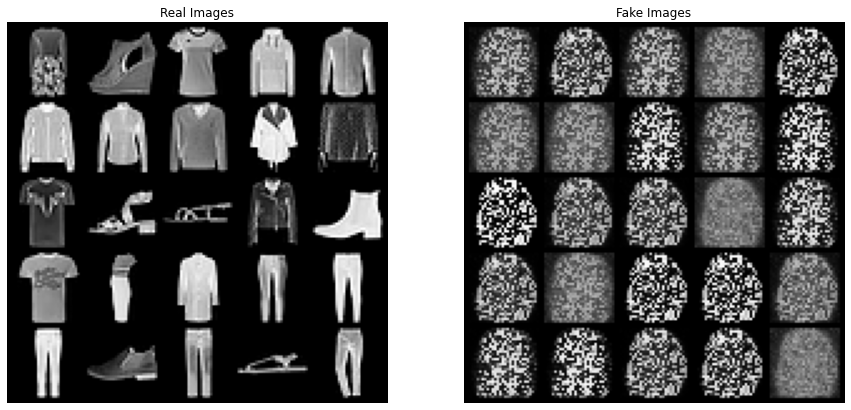

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 1/130] | [Step: 500/60970], Generator Loss: 0.5431600113709767, Discriminator Loss: 0.39483737635115784
[Epoch: 1/130] | [Step: 600/60970], Generator Loss: 0.5414315992966294, Discriminator Loss: 0.3933134349063039
[Epoch: 1/130] | [Step: 700/60970], Generator Loss: 0.5414596344344318, Discriminator Loss: 0.39327090326696634
[Epoch: 1/130] | [Step: 800/60970], Generator Loss: 0.5409192475490272, Discriminator Loss: 0.39435414504259825
[Epoch: 1/130] | [Step: 900/60970], Generator Loss: 0.48589482135139406, Discriminator Loss: 0.459657050203532


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 2/130] | [Step: 1000/60970], Generator Loss: 0.5253238499475023, Discriminator Loss: 0.41086484864354134
[Epoch: 2/130] | [Step: 1100/60970], Generator Loss: 0.5154723515734076, Discriminator Loss: 0.4235319667495787
[Epoch: 2/130] | [Step: 1200/60970], Generator Loss: 0.541313745547086, Discriminator Loss: 0.39354098262265325
[Epoch: 2/130] | [Step: 1300/60970], Generator Loss: 0.521753185428679, Discriminator Loss: 0.4140033219009638
[Epoch: 2/130] | [Step: 1400/60970], Generator Loss: 0.5413688728585839, Discriminator Loss: 0.39346384024247527


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 3/130] | [Step: 1500/60970], Generator Loss: 0.5432427126603822, Discriminator Loss: 0.39464091369882226
[Epoch: 3/130] | [Step: 1600/60970], Generator Loss: 0.5413899943232536, Discriminator Loss: 0.3933313055895269
[Epoch: 3/130] | [Step: 1700/60970], Generator Loss: 0.5390147641301155, Discriminator Loss: 0.39607033831998706
[Epoch: 3/130] | [Step: 1800/60970], Generator Loss: 0.5307064750231802, Discriminator Loss: 0.40551727917045355


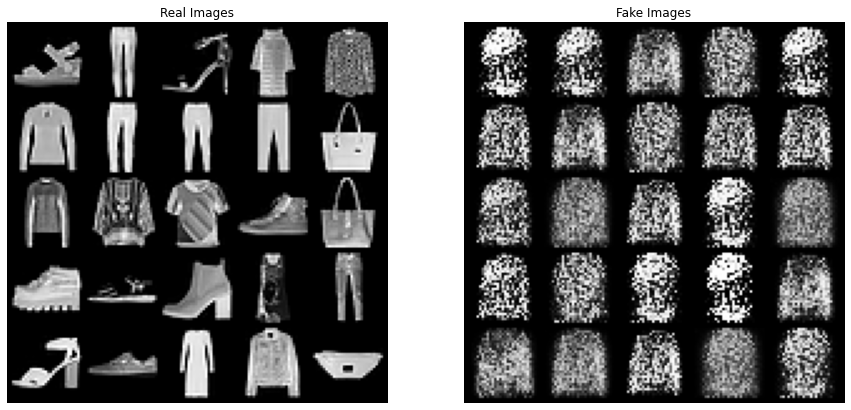

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 4/130] | [Step: 1900/60970], Generator Loss: 0.534553250297904, Discriminator Loss: 0.4067155406810343
[Epoch: 4/130] | [Step: 2000/60970], Generator Loss: 0.5375474528409541, Discriminator Loss: 0.40120110660791397
[Epoch: 4/130] | [Step: 2100/60970], Generator Loss: 0.5291095641441643, Discriminator Loss: 0.4272979195229709
[Epoch: 4/130] | [Step: 2200/60970], Generator Loss: 0.5389620359055698, Discriminator Loss: 0.4012973103672266
[Epoch: 4/130] | [Step: 2300/60970], Generator Loss: 0.5408318373374641, Discriminator Loss: 0.3948658420704305


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 5/130] | [Step: 2400/60970], Generator Loss: 0.542002416215837, Discriminator Loss: 0.3971282532438636
[Epoch: 5/130] | [Step: 2500/60970], Generator Loss: 0.5372664532624185, Discriminator Loss: 0.40000362042337656
[Epoch: 5/130] | [Step: 2600/60970], Generator Loss: 0.5387916704639792, Discriminator Loss: 0.4000340038910508
[Epoch: 5/130] | [Step: 2700/60970], Generator Loss: 0.5356063363142312, Discriminator Loss: 0.4043000624515116
[Epoch: 5/130] | [Step: 2800/60970], Generator Loss: 0.533321563154459, Discriminator Loss: 0.4123419071547687


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 6/130] | [Step: 2900/60970], Generator Loss: 0.5407245918177068, Discriminator Loss: 0.40192615473642945
[Epoch: 6/130] | [Step: 3000/60970], Generator Loss: 0.5355288004502654, Discriminator Loss: 0.4058257476426661
[Epoch: 6/130] | [Step: 3100/60970], Generator Loss: 0.538442412391305, Discriminator Loss: 0.3984306356869638
[Epoch: 6/130] | [Step: 3200/60970], Generator Loss: 0.5404736059717834, Discriminator Loss: 0.3952034283429384


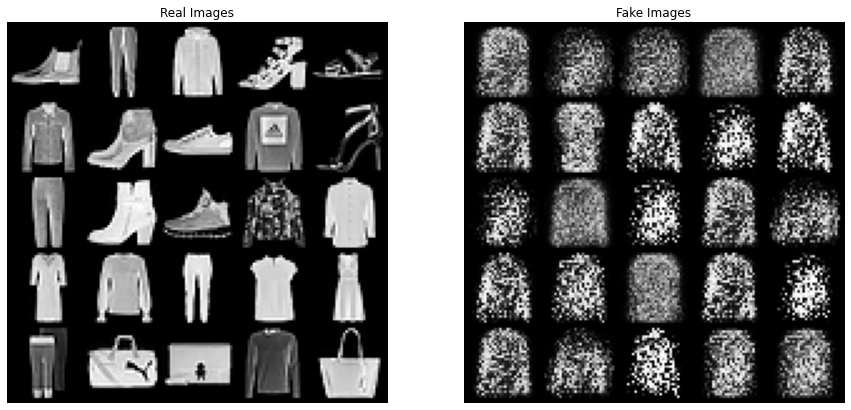

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 7/130] | [Step: 3300/60970], Generator Loss: 0.5388103846150141, Discriminator Loss: 0.4019663045182824
[Epoch: 7/130] | [Step: 3400/60970], Generator Loss: 0.538255478721112, Discriminator Loss: 0.39985163137316704
[Epoch: 7/130] | [Step: 3500/60970], Generator Loss: 0.5382039127871394, Discriminator Loss: 0.40010401140898466
[Epoch: 7/130] | [Step: 3600/60970], Generator Loss: 0.5406120656989515, Discriminator Loss: 0.39489135472103953
[Epoch: 7/130] | [Step: 3700/60970], Generator Loss: 0.5405269153416157, Discriminator Loss: 0.3952634851448238


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 8/130] | [Step: 3800/60970], Generator Loss: 0.5396461390579741, Discriminator Loss: 0.40425389554972446
[Epoch: 8/130] | [Step: 3900/60970], Generator Loss: 0.5399510250426829, Discriminator Loss: 0.39771882724016905
[Epoch: 8/130] | [Step: 4000/60970], Generator Loss: 0.5362957548350096, Discriminator Loss: 0.4088557669892907
[Epoch: 8/130] | [Step: 4100/60970], Generator Loss: 0.5342594599351287, Discriminator Loss: 0.41071281395852566
[Epoch: 8/130] | [Step: 4200/60970], Generator Loss: 0.5351396035403013, Discriminator Loss: 0.4066835604608059


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 9/130] | [Step: 4300/60970], Generator Loss: 0.5402804782303672, Discriminator Loss: 0.40251360430071753
[Epoch: 9/130] | [Step: 4400/60970], Generator Loss: 0.5296643571928144, Discriminator Loss: 0.4152348949573934
[Epoch: 9/130] | [Step: 4500/60970], Generator Loss: 0.5358742377720773, Discriminator Loss: 0.4105047155171633
[Epoch: 9/130] | [Step: 4600/60970], Generator Loss: 0.5387603640556335, Discriminator Loss: 0.39921071846038103


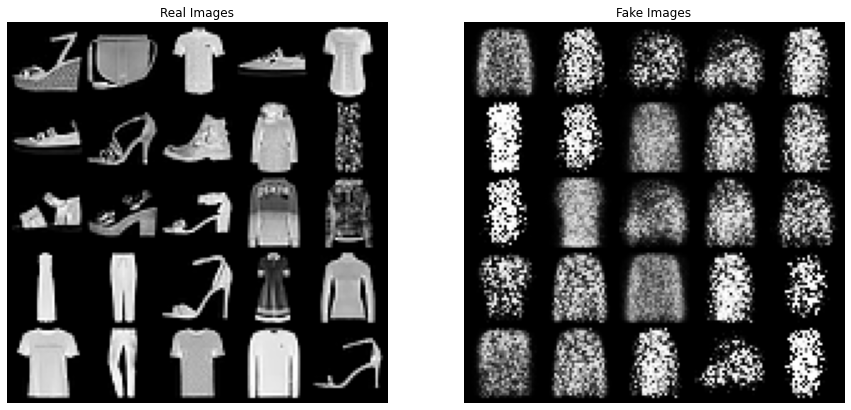

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 10/130] | [Step: 4700/60970], Generator Loss: 0.5409936170714598, Discriminator Loss: 0.40013888555889326
[Epoch: 10/130] | [Step: 4800/60970], Generator Loss: 0.5321073359809816, Discriminator Loss: 0.40911734383553267
[Epoch: 10/130] | [Step: 4900/60970], Generator Loss: 0.5356050175614655, Discriminator Loss: 0.4078621743246913
[Epoch: 10/130] | [Step: 5000/60970], Generator Loss: 0.53721715323627, Discriminator Loss: 0.406442285515368
[Epoch: 10/130] | [Step: 5100/60970], Generator Loss: 0.5395458280108869, Discriminator Loss: 0.3994986074976623


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 11/130] | [Step: 5200/60970], Generator Loss: 0.5371425421908498, Discriminator Loss: 0.4112845449708402
[Epoch: 11/130] | [Step: 5300/60970], Generator Loss: 0.5304286587052047, Discriminator Loss: 0.4110135706141591
[Epoch: 11/130] | [Step: 5400/60970], Generator Loss: 0.5414018598385155, Discriminator Loss: 0.3935273215174675
[Epoch: 11/130] | [Step: 5500/60970], Generator Loss: 0.5411015264689922, Discriminator Loss: 0.39389247074723244
[Epoch: 11/130] | [Step: 5600/60970], Generator Loss: 0.5359030566178262, Discriminator Loss: 0.4056007065810263


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 12/130] | [Step: 5700/60970], Generator Loss: 0.5295267789624631, Discriminator Loss: 0.4277365816136201
[Epoch: 12/130] | [Step: 5800/60970], Generator Loss: 0.5320252175442874, Discriminator Loss: 0.4061997667886317
[Epoch: 12/130] | [Step: 5900/60970], Generator Loss: 0.541341838426888, Discriminator Loss: 0.39372797403484583
[Epoch: 12/130] | [Step: 6000/60970], Generator Loss: 0.5412389179691672, Discriminator Loss: 0.39378856075927615


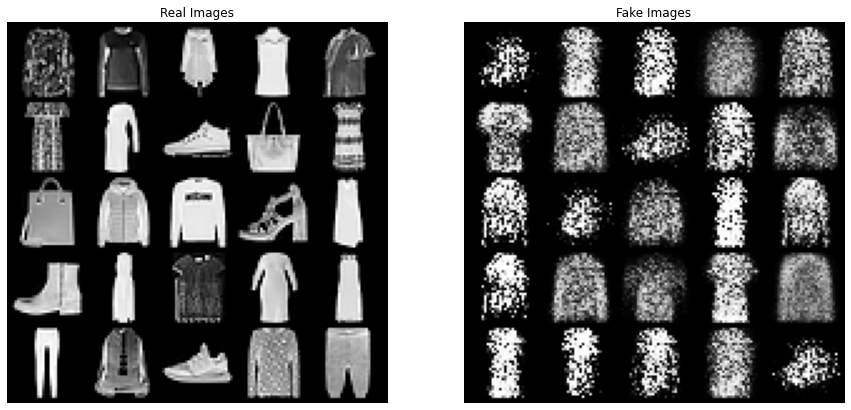

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 13/130] | [Step: 6100/60970], Generator Loss: 0.5426931595429778, Discriminator Loss: 0.3961774099928637
[Epoch: 13/130] | [Step: 6200/60970], Generator Loss: 0.5264429626986384, Discriminator Loss: 0.41943664010614157
[Epoch: 13/130] | [Step: 6300/60970], Generator Loss: 0.5350184985436499, Discriminator Loss: 0.4045570492744446
[Epoch: 13/130] | [Step: 6400/60970], Generator Loss: 0.5360903334803879, Discriminator Loss: 0.40266643837094307
[Epoch: 13/130] | [Step: 6500/60970], Generator Loss: 0.5347458338364959, Discriminator Loss: 0.40954629611223936


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 14/130] | [Step: 6600/60970], Generator Loss: 0.542480683264633, Discriminator Loss: 0.39731700516616303
[Epoch: 14/130] | [Step: 6700/60970], Generator Loss: 0.5376646998338401, Discriminator Loss: 0.39971133368089795
[Epoch: 14/130] | [Step: 6800/60970], Generator Loss: 0.5341870160773396, Discriminator Loss: 0.40767071675509214
[Epoch: 14/130] | [Step: 6900/60970], Generator Loss: 0.5347105045802891, Discriminator Loss: 0.405398472212255
[Epoch: 14/130] | [Step: 7000/60970], Generator Loss: 0.5339363780803978, Discriminator Loss: 0.41016068402677774


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 15/130] | [Step: 7100/60970], Generator Loss: 0.5405804091133177, Discriminator Loss: 0.40167252703880274
[Epoch: 15/130] | [Step: 7200/60970], Generator Loss: 0.5375536847859621, Discriminator Loss: 0.40279388800263405
[Epoch: 15/130] | [Step: 7300/60970], Generator Loss: 0.5311560714617372, Discriminator Loss: 0.4149599317461252
[Epoch: 15/130] | [Step: 7400/60970], Generator Loss: 0.539322707336396, Discriminator Loss: 0.39917306462302804
[Epoch: 15/130] | [Step: 7500/60970], Generator Loss: 0.5313172545284033, Discriminator Loss: 0.41249996796250343


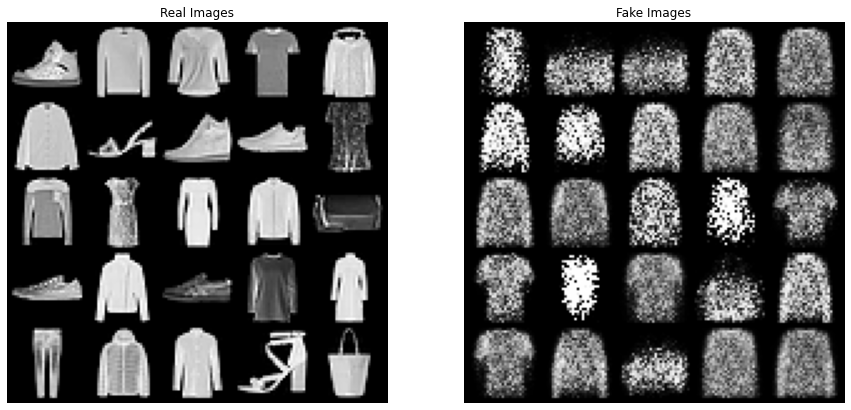

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 16/130] | [Step: 7600/60970], Generator Loss: 0.5404544089299936, Discriminator Loss: 0.40465835807844996
[Epoch: 16/130] | [Step: 7700/60970], Generator Loss: 0.5331703284755349, Discriminator Loss: 0.43056852370500565
[Epoch: 16/130] | [Step: 7800/60970], Generator Loss: 0.5321394396014512, Discriminator Loss: 0.41483562253415585
[Epoch: 16/130] | [Step: 7900/60970], Generator Loss: 0.5312422695569694, Discriminator Loss: 0.43004254158586264


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 17/130] | [Step: 8000/60970], Generator Loss: 0.5385047200446327, Discriminator Loss: 0.4092249403086801
[Epoch: 17/130] | [Step: 8100/60970], Generator Loss: 0.5370294386520982, Discriminator Loss: 0.4043020624667406
[Epoch: 17/130] | [Step: 8200/60970], Generator Loss: 0.5358811388723552, Discriminator Loss: 0.4113344121724367
[Epoch: 17/130] | [Step: 8300/60970], Generator Loss: 0.5329088876023889, Discriminator Loss: 0.4106162297539413
[Epoch: 17/130] | [Step: 8400/60970], Generator Loss: 0.534808078315109, Discriminator Loss: 0.4107235255651176


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 18/130] | [Step: 8500/60970], Generator Loss: 0.5375927452308437, Discriminator Loss: 0.41194432306413853
[Epoch: 18/130] | [Step: 8600/60970], Generator Loss: 0.534555516205728, Discriminator Loss: 0.4133870997466147
[Epoch: 18/130] | [Step: 8700/60970], Generator Loss: 0.5357678378932178, Discriminator Loss: 0.4112640214152634
[Epoch: 18/130] | [Step: 8800/60970], Generator Loss: 0.5356927048414946, Discriminator Loss: 0.4124759752303362
[Epoch: 18/130] | [Step: 8900/60970], Generator Loss: 0.5260781962424517, Discriminator Loss: 0.4342577615752816


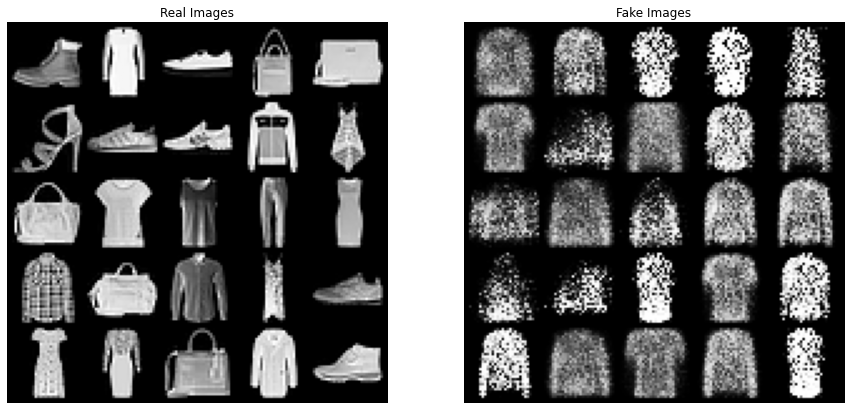

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 19/130] | [Step: 9000/60970], Generator Loss: 0.5392592465505004, Discriminator Loss: 0.4062298769131303
[Epoch: 19/130] | [Step: 9100/60970], Generator Loss: 0.5339138400740921, Discriminator Loss: 0.41440818924456835
[Epoch: 19/130] | [Step: 9200/60970], Generator Loss: 0.5309361442923546, Discriminator Loss: 0.42479407507926226
[Epoch: 19/130] | [Step: 9300/60970], Generator Loss: 0.5264641661196947, Discriminator Loss: 0.42719655577093363


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 20/130] | [Step: 9400/60970], Generator Loss: 0.5375330783426762, Discriminator Loss: 0.41889808016518754
[Epoch: 20/130] | [Step: 9500/60970], Generator Loss: 0.5314221926964819, Discriminator Loss: 0.4212182820774615
[Epoch: 20/130] | [Step: 9600/60970], Generator Loss: 0.5309859220869839, Discriminator Loss: 0.4272423852235079
[Epoch: 20/130] | [Step: 9700/60970], Generator Loss: 0.5356559823267162, Discriminator Loss: 0.40683412877842784
[Epoch: 20/130] | [Step: 9800/60970], Generator Loss: 0.5220484985038638, Discriminator Loss: 0.4397686207666993


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 21/130] | [Step: 9900/60970], Generator Loss: 0.5332760165135066, Discriminator Loss: 0.4238068934840461
[Epoch: 21/130] | [Step: 10000/60970], Generator Loss: 0.5322733852081001, Discriminator Loss: 0.42070369562134147
[Epoch: 21/130] | [Step: 10100/60970], Generator Loss: 0.5311745819635689, Discriminator Loss: 0.42482701782137156
[Epoch: 21/130] | [Step: 10200/60970], Generator Loss: 0.5358853479847312, Discriminator Loss: 0.4108559391461313
[Epoch: 21/130] | [Step: 10300/60970], Generator Loss: 0.5350396255962551, Discriminator Loss: 0.4144379151985049


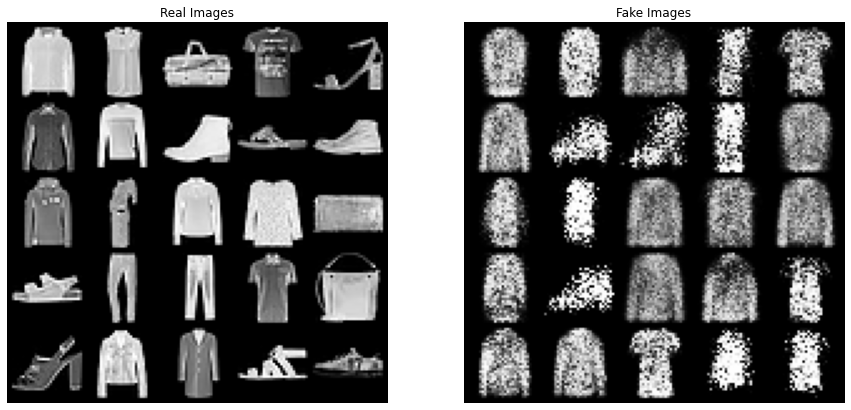

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 22/130] | [Step: 10400/60970], Generator Loss: 0.5358787394749622, Discriminator Loss: 0.4148518413615723
[Epoch: 22/130] | [Step: 10500/60970], Generator Loss: 0.5295120715163648, Discriminator Loss: 0.43744875909760594
[Epoch: 22/130] | [Step: 10600/60970], Generator Loss: 0.5289622615091503, Discriminator Loss: 0.4348947308026254
[Epoch: 22/130] | [Step: 10700/60970], Generator Loss: 0.5321587980724871, Discriminator Loss: 0.4423059127293527


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 23/130] | [Step: 10800/60970], Generator Loss: 0.5305423731915653, Discriminator Loss: 0.4385611363686621
[Epoch: 23/130] | [Step: 10900/60970], Generator Loss: 0.5300638480111957, Discriminator Loss: 0.43067752476781607
[Epoch: 23/130] | [Step: 11000/60970], Generator Loss: 0.5321520720608532, Discriminator Loss: 0.4172949739731848
[Epoch: 23/130] | [Step: 11100/60970], Generator Loss: 0.5314174299128354, Discriminator Loss: 0.4262799909338355
[Epoch: 23/130] | [Step: 11200/60970], Generator Loss: 0.5308486432768404, Discriminator Loss: 0.4236371982842684


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 24/130] | [Step: 11300/60970], Generator Loss: 0.5358791565522552, Discriminator Loss: 0.4147996469400823
[Epoch: 24/130] | [Step: 11400/60970], Generator Loss: 0.531849458348006, Discriminator Loss: 0.4170757965184748
[Epoch: 24/130] | [Step: 11500/60970], Generator Loss: 0.5204028966836631, Discriminator Loss: 0.43991497810930014
[Epoch: 24/130] | [Step: 11600/60970], Generator Loss: 0.5252834698185325, Discriminator Loss: 0.43008922366425395
[Epoch: 24/130] | [Step: 11700/60970], Generator Loss: 0.5337537806481123, Discriminator Loss: 0.4173958320170641


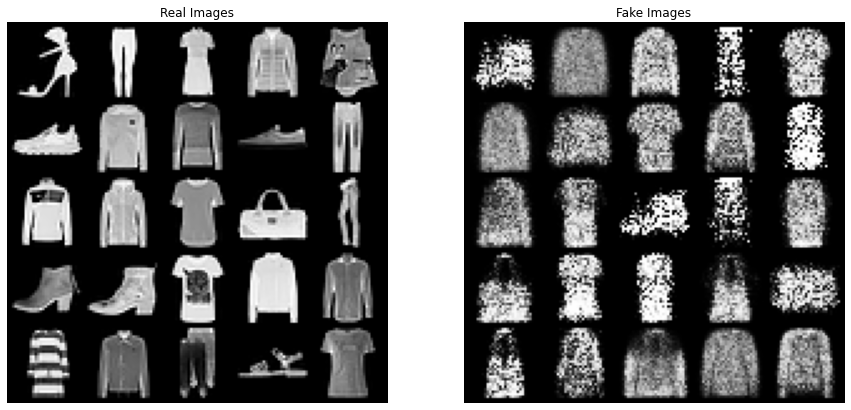

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 25/130] | [Step: 11800/60970], Generator Loss: 0.533844671677798, Discriminator Loss: 0.42366681310037774
[Epoch: 25/130] | [Step: 11900/60970], Generator Loss: 0.529681118670851, Discriminator Loss: 0.4281078828498721
[Epoch: 25/130] | [Step: 12000/60970], Generator Loss: 0.5314541873522103, Discriminator Loss: 0.4293879228644073
[Epoch: 25/130] | [Step: 12100/60970], Generator Loss: 0.5235149287618697, Discriminator Loss: 0.4475543303415179


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 26/130] | [Step: 12200/60970], Generator Loss: 0.5346490902205308, Discriminator Loss: 0.42354431344817084
[Epoch: 26/130] | [Step: 12300/60970], Generator Loss: 0.5319430315867066, Discriminator Loss: 0.42449216870591044
[Epoch: 26/130] | [Step: 12400/60970], Generator Loss: 0.5266878544352949, Discriminator Loss: 0.4388758270069957
[Epoch: 26/130] | [Step: 12500/60970], Generator Loss: 0.5333805335685611, Discriminator Loss: 0.4166066199541092
[Epoch: 26/130] | [Step: 12600/60970], Generator Loss: 0.5335410232655704, Discriminator Loss: 0.42355715297162533


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 27/130] | [Step: 12700/60970], Generator Loss: 0.532956862046073, Discriminator Loss: 0.4440227821469307
[Epoch: 27/130] | [Step: 12800/60970], Generator Loss: 0.5301913185976446, Discriminator Loss: 0.4371517589315772
[Epoch: 27/130] | [Step: 12900/60970], Generator Loss: 0.5254697403870523, Discriminator Loss: 0.449192238971591
[Epoch: 27/130] | [Step: 13000/60970], Generator Loss: 0.5336693618446589, Discriminator Loss: 0.4198538321070373
[Epoch: 27/130] | [Step: 13100/60970], Generator Loss: 0.5311750313267112, Discriminator Loss: 0.4500694046728313


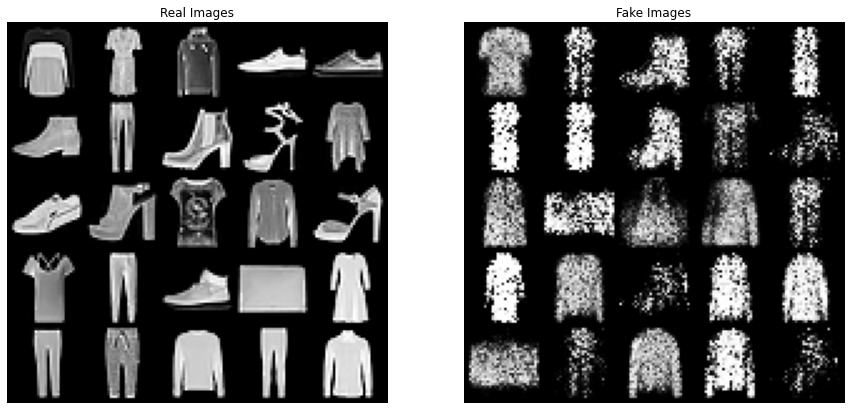

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 28/130] | [Step: 13200/60970], Generator Loss: 0.5346110809283952, Discriminator Loss: 0.42902450915426016
[Epoch: 28/130] | [Step: 13300/60970], Generator Loss: 0.526615594048053, Discriminator Loss: 0.42492519691586494
[Epoch: 28/130] | [Step: 13400/60970], Generator Loss: 0.5270886225625873, Discriminator Loss: 0.4442280321381986
[Epoch: 28/130] | [Step: 13500/60970], Generator Loss: 0.5335553931072354, Discriminator Loss: 0.415645360480994
[Epoch: 28/130] | [Step: 13600/60970], Generator Loss: 0.5107226894857982, Discriminator Loss: 0.4617811096832156


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 29/130] | [Step: 13700/60970], Generator Loss: 0.5262302793562412, Discriminator Loss: 0.4386252509430051
[Epoch: 29/130] | [Step: 13800/60970], Generator Loss: 0.5191775634884834, Discriminator Loss: 0.4561516265384853
[Epoch: 29/130] | [Step: 13900/60970], Generator Loss: 0.5295179593376815, Discriminator Loss: 0.43351964466273785
[Epoch: 29/130] | [Step: 14000/60970], Generator Loss: 0.5238796682097018, Discriminator Loss: 0.46897829743102193


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 30/130] | [Step: 14100/60970], Generator Loss: 0.5217845756560564, Discriminator Loss: 0.4444565661251545
[Epoch: 30/130] | [Step: 14200/60970], Generator Loss: 0.5273591270670295, Discriminator Loss: 0.43749832501634955
[Epoch: 30/130] | [Step: 14300/60970], Generator Loss: 0.5284542283043265, Discriminator Loss: 0.4460280635394156
[Epoch: 30/130] | [Step: 14400/60970], Generator Loss: 0.5212339335121214, Discriminator Loss: 0.4503247672691941
[Epoch: 30/130] | [Step: 14500/60970], Generator Loss: 0.526301902718842, Discriminator Loss: 0.43266909243538976


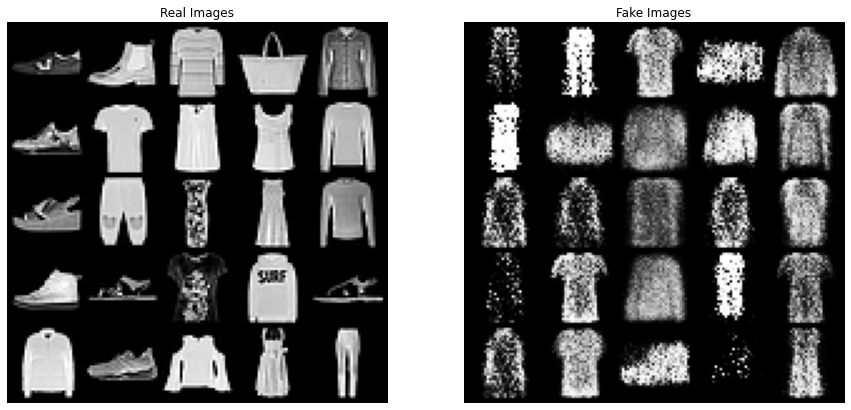

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 31/130] | [Step: 14600/60970], Generator Loss: 0.5191499792660276, Discriminator Loss: 0.4781251549720764
[Epoch: 31/130] | [Step: 14700/60970], Generator Loss: 0.5178387495689094, Discriminator Loss: 0.45761659648269415
[Epoch: 31/130] | [Step: 14800/60970], Generator Loss: 0.5277070868760347, Discriminator Loss: 0.46127378894016147
[Epoch: 31/130] | [Step: 14900/60970], Generator Loss: 0.527005416341126, Discriminator Loss: 0.4520166660659015
[Epoch: 31/130] | [Step: 15000/60970], Generator Loss: 0.519634650554508, Discriminator Loss: 0.44243909884244204


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 32/130] | [Step: 15100/60970], Generator Loss: 0.530859874561429, Discriminator Loss: 0.43483675038442016
[Epoch: 32/130] | [Step: 15200/60970], Generator Loss: 0.5241891625337303, Discriminator Loss: 0.4587449016980827
[Epoch: 32/130] | [Step: 15300/60970], Generator Loss: 0.5306724216789007, Discriminator Loss: 0.4226404782384634
[Epoch: 32/130] | [Step: 15400/60970], Generator Loss: 0.4981561480090022, Discriminator Loss: 0.46481214417144656


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 33/130] | [Step: 15500/60970], Generator Loss: 0.530358358907203, Discriminator Loss: 0.4377958291831116
[Epoch: 33/130] | [Step: 15600/60970], Generator Loss: 0.520966624841094, Discriminator Loss: 0.47832111129537225
[Epoch: 33/130] | [Step: 15700/60970], Generator Loss: 0.5310512203723192, Discriminator Loss: 0.421868905890733
[Epoch: 33/130] | [Step: 15800/60970], Generator Loss: 0.5266032102517784, Discriminator Loss: 0.44849492982029915
[Epoch: 33/130] | [Step: 15900/60970], Generator Loss: 0.5286291535012424, Discriminator Loss: 0.4321582866832614


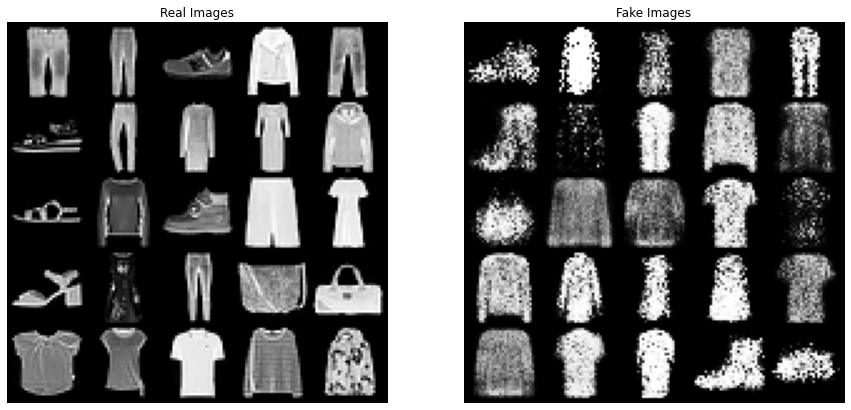

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 34/130] | [Step: 16000/60970], Generator Loss: 0.5293393065221608, Discriminator Loss: 0.44458586225907004
[Epoch: 34/130] | [Step: 16100/60970], Generator Loss: 0.5230068550445139, Discriminator Loss: 0.4609118001535535
[Epoch: 34/130] | [Step: 16200/60970], Generator Loss: 0.530094119720161, Discriminator Loss: 0.44179285410791636
[Epoch: 34/130] | [Step: 16300/60970], Generator Loss: 0.5080590946599841, Discriminator Loss: 0.456540544051677
[Epoch: 34/130] | [Step: 16400/60970], Generator Loss: 0.5316097494214773, Discriminator Loss: 0.4207954746671021


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 35/130] | [Step: 16500/60970], Generator Loss: 0.5243687910648684, Discriminator Loss: 0.4683621822235485
[Epoch: 35/130] | [Step: 16600/60970], Generator Loss: 0.5276338462717831, Discriminator Loss: 0.43341351859271526
[Epoch: 35/130] | [Step: 16700/60970], Generator Loss: 0.5230152010917664, Discriminator Loss: 0.450421295594424
[Epoch: 35/130] | [Step: 16800/60970], Generator Loss: 0.5248793778009713, Discriminator Loss: 0.4633486792445183


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 36/130] | [Step: 16900/60970], Generator Loss: 0.5216669326958556, Discriminator Loss: 0.4557305940737327
[Epoch: 36/130] | [Step: 17000/60970], Generator Loss: 0.5231600878760219, Discriminator Loss: 0.45443934202194214
[Epoch: 36/130] | [Step: 17100/60970], Generator Loss: 0.5302894082851708, Discriminator Loss: 0.42915333434939384
[Epoch: 36/130] | [Step: 17200/60970], Generator Loss: 0.5247812904417515, Discriminator Loss: 0.44664975395426154
[Epoch: 36/130] | [Step: 17300/60970], Generator Loss: 0.5300927292555571, Discriminator Loss: 0.43621015921235085


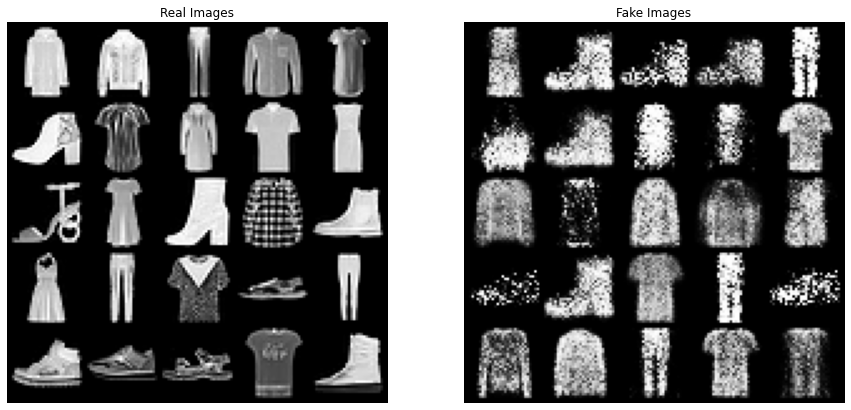

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 37/130] | [Step: 17400/60970], Generator Loss: 0.5258154768186312, Discriminator Loss: 0.4727806577769419
[Epoch: 37/130] | [Step: 17500/60970], Generator Loss: 0.5270802993327379, Discriminator Loss: 0.43900602124631405
[Epoch: 37/130] | [Step: 17600/60970], Generator Loss: 0.5282927975058556, Discriminator Loss: 0.4311069715768099
[Epoch: 37/130] | [Step: 17700/60970], Generator Loss: 0.5222983337007463, Discriminator Loss: 0.46205007238313556
[Epoch: 37/130] | [Step: 17800/60970], Generator Loss: 0.5210158452391624, Discriminator Loss: 0.45479941135272384


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 38/130] | [Step: 17900/60970], Generator Loss: 0.5301691197479765, Discriminator Loss: 0.4395088378029565
[Epoch: 38/130] | [Step: 18000/60970], Generator Loss: 0.5243331794627011, Discriminator Loss: 0.4512219559401274
[Epoch: 38/130] | [Step: 18100/60970], Generator Loss: 0.5245888154022396, Discriminator Loss: 0.4361603460274637
[Epoch: 38/130] | [Step: 18200/60970], Generator Loss: 0.5234033488668501, Discriminator Loss: 0.4489353424869478


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 39/130] | [Step: 18300/60970], Generator Loss: 0.5238730884157121, Discriminator Loss: 0.4642989148075382
[Epoch: 39/130] | [Step: 18400/60970], Generator Loss: 0.525791515596211, Discriminator Loss: 0.44534648256376386
[Epoch: 39/130] | [Step: 18500/60970], Generator Loss: 0.5228181430138648, Discriminator Loss: 0.4689548541791737
[Epoch: 39/130] | [Step: 18600/60970], Generator Loss: 0.5285698166117072, Discriminator Loss: 0.43567396560683846
[Epoch: 39/130] | [Step: 18700/60970], Generator Loss: 0.5254169907420874, Discriminator Loss: 0.45597553346306086


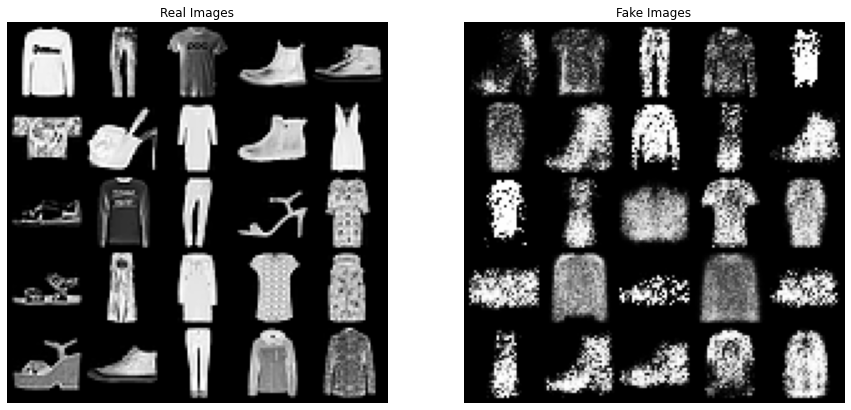

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 40/130] | [Step: 18800/60970], Generator Loss: 0.5289808580030997, Discriminator Loss: 0.44190014293417335
[Epoch: 40/130] | [Step: 18900/60970], Generator Loss: 0.5235762726515532, Discriminator Loss: 0.4561823755502701
[Epoch: 40/130] | [Step: 19000/60970], Generator Loss: 0.5280829602852464, Discriminator Loss: 0.4431195710785687
[Epoch: 40/130] | [Step: 19100/60970], Generator Loss: 0.516991201788187, Discriminator Loss: 0.4657988976687193
[Epoch: 40/130] | [Step: 19200/60970], Generator Loss: 0.5236896867863834, Discriminator Loss: 0.44789988454431295


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 41/130] | [Step: 19300/60970], Generator Loss: 0.5222775346289078, Discriminator Loss: 0.464612087700516
[Epoch: 41/130] | [Step: 19400/60970], Generator Loss: 0.5215601157397032, Discriminator Loss: 0.45392925944179296
[Epoch: 41/130] | [Step: 19500/60970], Generator Loss: 0.5284319771453738, Discriminator Loss: 0.48515877593308687
[Epoch: 41/130] | [Step: 19600/60970], Generator Loss: 0.5259013972245157, Discriminator Loss: 0.44879473792389035


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 42/130] | [Step: 19700/60970], Generator Loss: 0.5209593016964694, Discriminator Loss: 0.4566652365028858
[Epoch: 42/130] | [Step: 19800/60970], Generator Loss: 0.5206839772872627, Discriminator Loss: 0.45413093315437436
[Epoch: 42/130] | [Step: 19900/60970], Generator Loss: 0.5228933691978455, Discriminator Loss: 0.46049245819449425
[Epoch: 42/130] | [Step: 20000/60970], Generator Loss: 0.5190587937831879, Discriminator Loss: 0.45685827219858766
[Epoch: 42/130] | [Step: 20100/60970], Generator Loss: 0.5231291293166578, Discriminator Loss: 0.44794288696721196


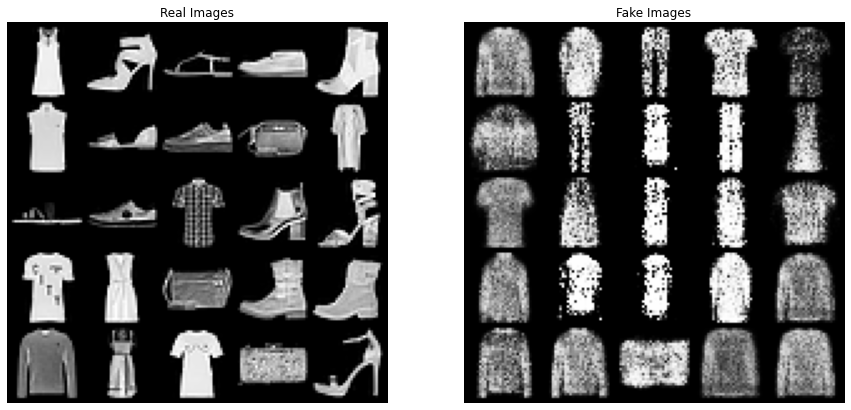

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 43/130] | [Step: 20200/60970], Generator Loss: 0.5221432459851105, Discriminator Loss: 0.47393824222187203
[Epoch: 43/130] | [Step: 20300/60970], Generator Loss: 0.5264146667905152, Discriminator Loss: 0.46566725755110383
[Epoch: 43/130] | [Step: 20400/60970], Generator Loss: 0.5236803810112178, Discriminator Loss: 0.4646118846721947
[Epoch: 43/130] | [Step: 20500/60970], Generator Loss: 0.5253692623227835, Discriminator Loss: 0.44567031040787697
[Epoch: 43/130] | [Step: 20600/60970], Generator Loss: 0.5240872595459223, Discriminator Loss: 0.46487555047497153


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 44/130] | [Step: 20700/60970], Generator Loss: 0.5247682497526208, Discriminator Loss: 0.4459479275780419
[Epoch: 44/130] | [Step: 20800/60970], Generator Loss: 0.5188409709371626, Discriminator Loss: 0.45952339097857475
[Epoch: 44/130] | [Step: 20900/60970], Generator Loss: 0.5267697181552649, Discriminator Loss: 0.4410069906152785
[Epoch: 44/130] | [Step: 21000/60970], Generator Loss: 0.5182010997086763, Discriminator Loss: 0.4544260995462537
[Epoch: 44/130] | [Step: 21100/60970], Generator Loss: 0.5243214732035995, Discriminator Loss: 0.4714074023067951


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 45/130] | [Step: 21200/60970], Generator Loss: 0.5175960189662874, Discriminator Loss: 0.4699690684986611
[Epoch: 45/130] | [Step: 21300/60970], Generator Loss: 0.5249918601475656, Discriminator Loss: 0.464645829051733
[Epoch: 45/130] | [Step: 21400/60970], Generator Loss: 0.5189090883359313, Discriminator Loss: 0.46565701998770237
[Epoch: 45/130] | [Step: 21500/60970], Generator Loss: 0.520766613073647, Discriminator Loss: 0.47232519555836916


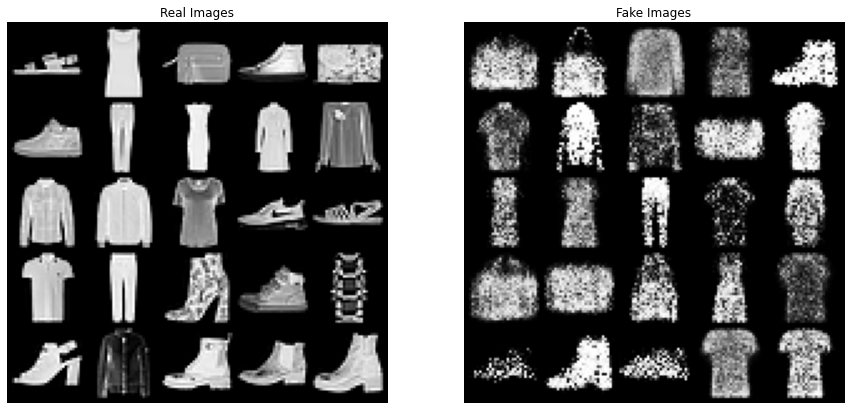

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 46/130] | [Step: 21600/60970], Generator Loss: 0.5224462184123695, Discriminator Loss: 0.46395493966216844
[Epoch: 46/130] | [Step: 21700/60970], Generator Loss: 0.5194252459332347, Discriminator Loss: 0.45860073948279023
[Epoch: 46/130] | [Step: 21800/60970], Generator Loss: 0.5229102023877203, Discriminator Loss: 0.49159215623512864
[Epoch: 46/130] | [Step: 21900/60970], Generator Loss: 0.5248350095935166, Discriminator Loss: 0.46007817052304745
[Epoch: 46/130] | [Step: 22000/60970], Generator Loss: 0.5072663556784391, Discriminator Loss: 0.475700571667403


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 47/130] | [Step: 22100/60970], Generator Loss: 0.5186066959674159, Discriminator Loss: 0.46772425870100653
[Epoch: 47/130] | [Step: 22200/60970], Generator Loss: 0.5222974088974297, Discriminator Loss: 0.4597312919795513
[Epoch: 47/130] | [Step: 22300/60970], Generator Loss: 0.5180405382998288, Discriminator Loss: 0.4614573288708925
[Epoch: 47/130] | [Step: 22400/60970], Generator Loss: 0.5134770199656487, Discriminator Loss: 0.4628798132762313
[Epoch: 47/130] | [Step: 22500/60970], Generator Loss: 0.5198067938908935, Discriminator Loss: 0.46608814084902406


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 48/130] | [Step: 22600/60970], Generator Loss: 0.5221513208622733, Discriminator Loss: 0.468530848932763
[Epoch: 48/130] | [Step: 22700/60970], Generator Loss: 0.5266414708457887, Discriminator Loss: 0.46678079292178154
[Epoch: 48/130] | [Step: 22800/60970], Generator Loss: 0.5252893269062042, Discriminator Loss: 0.4468568544834852
[Epoch: 48/130] | [Step: 22900/60970], Generator Loss: 0.5111481160856783, Discriminator Loss: 0.4747483874671161


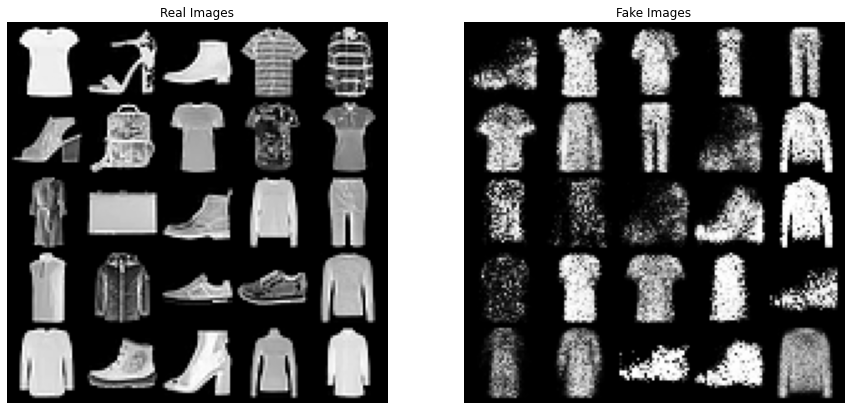

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 49/130] | [Step: 23000/60970], Generator Loss: 0.5236840920212369, Discriminator Loss: 0.47519456253697473
[Epoch: 49/130] | [Step: 23100/60970], Generator Loss: 0.5261779534630477, Discriminator Loss: 0.49180686520412564
[Epoch: 49/130] | [Step: 23200/60970], Generator Loss: 0.5214185705408454, Discriminator Loss: 0.4745164974592626
[Epoch: 49/130] | [Step: 23300/60970], Generator Loss: 0.5232065017335117, Discriminator Loss: 0.4611477111466229
[Epoch: 49/130] | [Step: 23400/60970], Generator Loss: 0.524466987233609, Discriminator Loss: 0.4504321594722569


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 50/130] | [Step: 23500/60970], Generator Loss: 0.5188026134856045, Discriminator Loss: 0.48367094465841853
[Epoch: 50/130] | [Step: 23600/60970], Generator Loss: 0.5240053944289684, Discriminator Loss: 0.45085674338042736
[Epoch: 50/130] | [Step: 23700/60970], Generator Loss: 0.5159625271335244, Discriminator Loss: 0.46708248602226377
[Epoch: 50/130] | [Step: 23800/60970], Generator Loss: 0.5233700843527913, Discriminator Loss: 0.4973072591237724
[Epoch: 50/130] | [Step: 23900/60970], Generator Loss: 0.5208406588062644, Discriminator Loss: 0.48479706794023514


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 51/130] | [Step: 24000/60970], Generator Loss: 0.5170835306247075, Discriminator Loss: 0.479272414619724
[Epoch: 51/130] | [Step: 24100/60970], Generator Loss: 0.5160317346453667, Discriminator Loss: 0.4677271922118962
[Epoch: 51/130] | [Step: 24200/60970], Generator Loss: 0.5253382348455489, Discriminator Loss: 0.483707751147449
[Epoch: 51/130] | [Step: 24300/60970], Generator Loss: 0.5243287170305848, Discriminator Loss: 0.48119444120675325


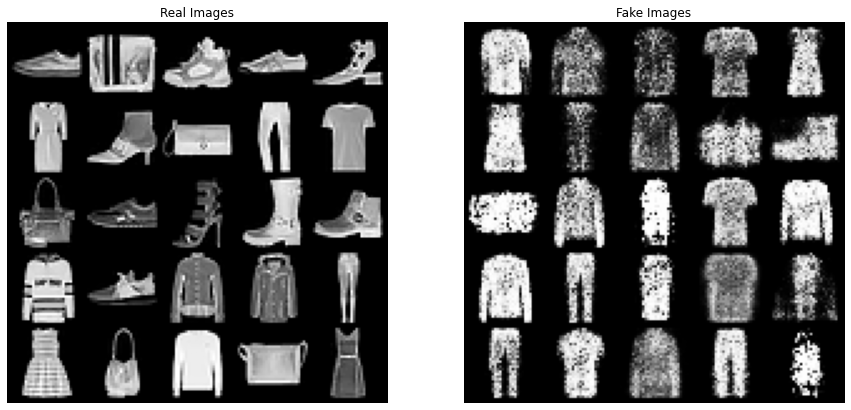

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 52/130] | [Step: 24400/60970], Generator Loss: 0.5240546955416601, Discriminator Loss: 0.47584407885248464
[Epoch: 52/130] | [Step: 24500/60970], Generator Loss: 0.5236922316253185, Discriminator Loss: 0.4810651089064777
[Epoch: 52/130] | [Step: 24600/60970], Generator Loss: 0.5205358434468508, Discriminator Loss: 0.4872276126407087
[Epoch: 52/130] | [Step: 24700/60970], Generator Loss: 0.5184480757452548, Discriminator Loss: 0.4678517756983638
[Epoch: 52/130] | [Step: 24800/60970], Generator Loss: 0.525052702985704, Discriminator Loss: 0.4646147140301764


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 53/130] | [Step: 24900/60970], Generator Loss: 0.5194185830963154, Discriminator Loss: 0.4651461540100475
[Epoch: 53/130] | [Step: 25000/60970], Generator Loss: 0.5137583478353918, Discriminator Loss: 0.4624117808416486
[Epoch: 53/130] | [Step: 25100/60970], Generator Loss: 0.525056114885956, Discriminator Loss: 0.47345626959577203
[Epoch: 53/130] | [Step: 25200/60970], Generator Loss: 0.5206448105163872, Discriminator Loss: 0.46404823986813426
[Epoch: 53/130] | [Step: 25300/60970], Generator Loss: 0.5198922147974372, Discriminator Loss: 0.45176507253199816


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 54/130] | [Step: 25400/60970], Generator Loss: 0.5219118211728832, Discriminator Loss: 0.46409364820768434
[Epoch: 54/130] | [Step: 25500/60970], Generator Loss: 0.5189304226078093, Discriminator Loss: 0.4695121203549206
[Epoch: 54/130] | [Step: 25600/60970], Generator Loss: 0.515863845590502, Discriminator Loss: 0.48182063456624746
[Epoch: 54/130] | [Step: 25700/60970], Generator Loss: 0.5155801591463387, Discriminator Loss: 0.4723466238938272


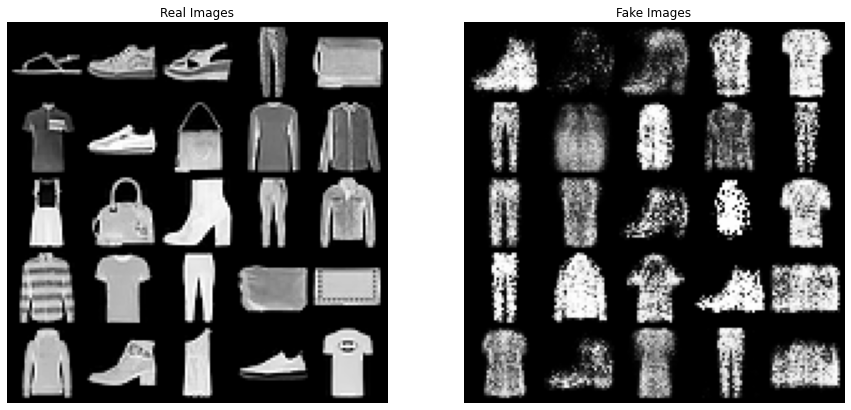

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 55/130] | [Step: 25800/60970], Generator Loss: 0.5179738964264591, Discriminator Loss: 0.4826719402335584
[Epoch: 55/130] | [Step: 25900/60970], Generator Loss: 0.5214947909116745, Discriminator Loss: 0.4617196270264685
[Epoch: 55/130] | [Step: 26000/60970], Generator Loss: 0.5230174139142036, Discriminator Loss: 0.4808045490644872
[Epoch: 55/130] | [Step: 26100/60970], Generator Loss: 0.5206538694910705, Discriminator Loss: 0.4721329710446298
[Epoch: 55/130] | [Step: 26200/60970], Generator Loss: 0.5246266778558493, Discriminator Loss: 0.4779526712372899


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 56/130] | [Step: 26300/60970], Generator Loss: 0.5207074492548902, Discriminator Loss: 0.469795916074266
[Epoch: 56/130] | [Step: 26400/60970], Generator Loss: 0.5107848141342402, Discriminator Loss: 0.4898806572891772
[Epoch: 56/130] | [Step: 26500/60970], Generator Loss: 0.524277956224978, Discriminator Loss: 0.4517721491865814
[Epoch: 56/130] | [Step: 26600/60970], Generator Loss: 0.51863151229918, Discriminator Loss: 0.48832879634574056
[Epoch: 56/130] | [Step: 26700/60970], Generator Loss: 0.5206934120506048, Discriminator Loss: 0.4506562976166606


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 57/130] | [Step: 26800/60970], Generator Loss: 0.5218805018812418, Discriminator Loss: 0.48017152693743503
[Epoch: 57/130] | [Step: 26900/60970], Generator Loss: 0.5196596062742174, Discriminator Loss: 0.4807519423775375
[Epoch: 57/130] | [Step: 27000/60970], Generator Loss: 0.5174098890274763, Discriminator Loss: 0.471026208717376
[Epoch: 57/130] | [Step: 27100/60970], Generator Loss: 0.5204594251699746, Discriminator Loss: 0.47912096977233887
[Epoch: 57/130] | [Step: 27200/60970], Generator Loss: 0.513560586143285, Discriminator Loss: 0.4779584379866719


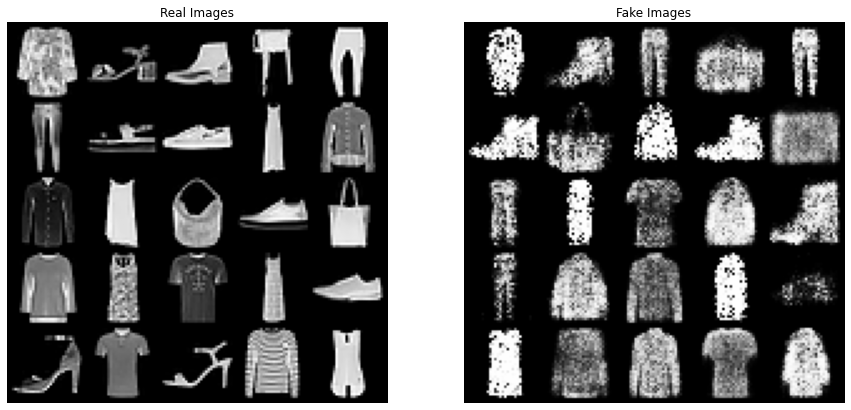

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 58/130] | [Step: 27300/60970], Generator Loss: 0.5213153554747503, Discriminator Loss: 0.4767501576182743
[Epoch: 58/130] | [Step: 27400/60970], Generator Loss: 0.5162537638098001, Discriminator Loss: 0.48543341970071197
[Epoch: 58/130] | [Step: 27500/60970], Generator Loss: 0.5140754729509354, Discriminator Loss: 0.4991253879852593
[Epoch: 58/130] | [Step: 27600/60970], Generator Loss: 0.5157372117973864, Discriminator Loss: 0.4805901241488755


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 59/130] | [Step: 27700/60970], Generator Loss: 0.5247171330265701, Discriminator Loss: 0.4748097946867347
[Epoch: 59/130] | [Step: 27800/60970], Generator Loss: 0.5298047889955342, Discriminator Loss: 0.5202359156683087
[Epoch: 59/130] | [Step: 27900/60970], Generator Loss: 0.5306670470163226, Discriminator Loss: 0.5059993504546583
[Epoch: 59/130] | [Step: 28000/60970], Generator Loss: 0.5139292608946562, Discriminator Loss: 0.46691179228946567
[Epoch: 59/130] | [Step: 28100/60970], Generator Loss: 0.5154900094494224, Discriminator Loss: 0.5131557905115187


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 60/130] | [Step: 28200/60970], Generator Loss: 0.5167489301723739, Discriminator Loss: 0.48332741453001893
[Epoch: 60/130] | [Step: 28300/60970], Generator Loss: 0.5235983831807971, Discriminator Loss: 0.4843115280382335
[Epoch: 60/130] | [Step: 28400/60970], Generator Loss: 0.5227925470098853, Discriminator Loss: 0.48913471354171634
[Epoch: 60/130] | [Step: 28500/60970], Generator Loss: 0.5182705302722752, Discriminator Loss: 0.4656963893212378
[Epoch: 60/130] | [Step: 28600/60970], Generator Loss: 0.5157649931497872, Discriminator Loss: 0.49843215430155396


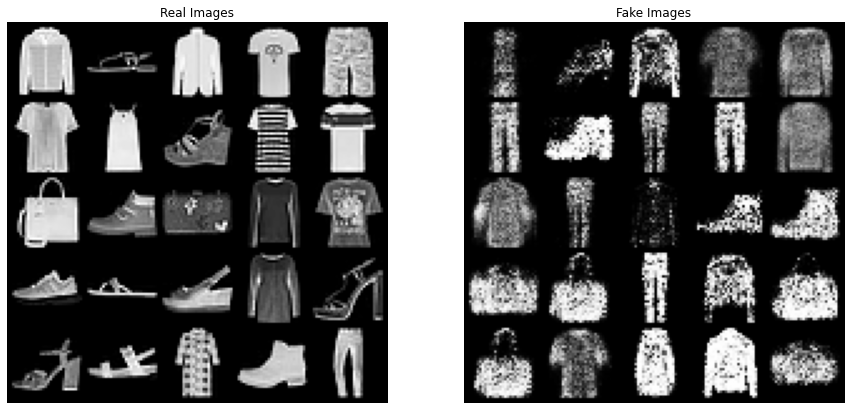

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 61/130] | [Step: 28700/60970], Generator Loss: 0.5245224990261098, Discriminator Loss: 0.49598607436443365
[Epoch: 61/130] | [Step: 28800/60970], Generator Loss: 0.5114027559757233, Discriminator Loss: 0.4792781895957887
[Epoch: 61/130] | [Step: 28900/60970], Generator Loss: 0.5290056620724499, Discriminator Loss: 0.4994181953370571
[Epoch: 61/130] | [Step: 29000/60970], Generator Loss: 0.5125898062251508, Discriminator Loss: 0.4799528094008565


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 62/130] | [Step: 29100/60970], Generator Loss: 0.5231267220030229, Discriminator Loss: 0.46663125744089484
[Epoch: 62/130] | [Step: 29200/60970], Generator Loss: 0.5114228976890445, Discriminator Loss: 0.4981911019422114
[Epoch: 62/130] | [Step: 29300/60970], Generator Loss: 0.5156048028729856, Discriminator Loss: 0.49585978919640183
[Epoch: 62/130] | [Step: 29400/60970], Generator Loss: 0.5100423078984022, Discriminator Loss: 0.4729414898902178
[Epoch: 62/130] | [Step: 29500/60970], Generator Loss: 0.5151920677162707, Discriminator Loss: 0.46604278171435


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 63/130] | [Step: 29600/60970], Generator Loss: 0.5212532932249209, Discriminator Loss: 0.46779692436878884
[Epoch: 63/130] | [Step: 29700/60970], Generator Loss: 0.517913790885359, Discriminator Loss: 0.4778361702337861
[Epoch: 63/130] | [Step: 29800/60970], Generator Loss: 0.5152588598430157, Discriminator Loss: 0.4744501505047083
[Epoch: 63/130] | [Step: 29900/60970], Generator Loss: 0.5191114810295403, Discriminator Loss: 0.4746684725396335
[Epoch: 63/130] | [Step: 30000/60970], Generator Loss: 0.5176479634828866, Discriminator Loss: 0.4759181244298816


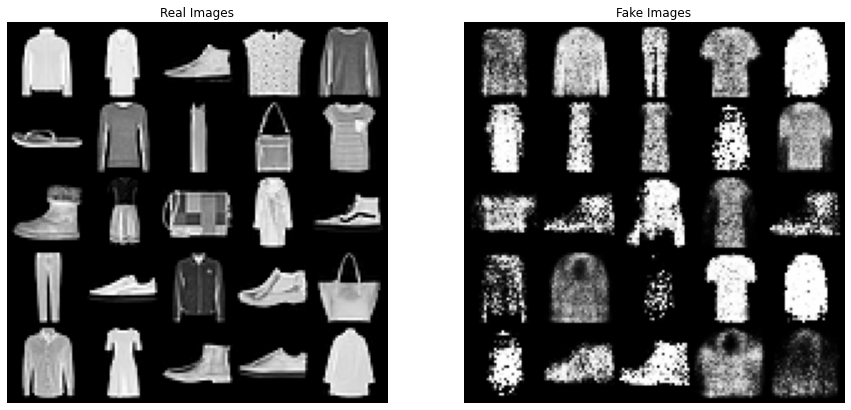

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 64/130] | [Step: 30100/60970], Generator Loss: 0.5191894654805462, Discriminator Loss: 0.4782292398934563
[Epoch: 64/130] | [Step: 30200/60970], Generator Loss: 0.517627680208534, Discriminator Loss: 0.4994057840667665
[Epoch: 64/130] | [Step: 30300/60970], Generator Loss: 0.5164272747933865, Discriminator Loss: 0.47445059893652797
[Epoch: 64/130] | [Step: 30400/60970], Generator Loss: 0.5180266671814024, Discriminator Loss: 0.49299199040979147


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 65/130] | [Step: 30500/60970], Generator Loss: 0.5204227793340881, Discriminator Loss: 0.49388962440813583
[Epoch: 65/130] | [Step: 30600/60970], Generator Loss: 0.5180160999298096, Discriminator Loss: 0.45765596721321344
[Epoch: 65/130] | [Step: 30700/60970], Generator Loss: 0.5200329637154937, Discriminator Loss: 0.48914879420772195
[Epoch: 65/130] | [Step: 30800/60970], Generator Loss: 0.5180812878534198, Discriminator Loss: 0.4626466650515795
[Epoch: 65/130] | [Step: 30900/60970], Generator Loss: 0.5190419303253293, Discriminator Loss: 0.4629888962954283


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 66/130] | [Step: 31000/60970], Generator Loss: 0.5226358133368194, Discriminator Loss: 0.48227612550059956
[Epoch: 66/130] | [Step: 31100/60970], Generator Loss: 0.5119772562757134, Discriminator Loss: 0.4875611471943557
[Epoch: 66/130] | [Step: 31200/60970], Generator Loss: 0.5165277384221554, Discriminator Loss: 0.4838166143745184
[Epoch: 66/130] | [Step: 31300/60970], Generator Loss: 0.5143426614813507, Discriminator Loss: 0.5017065526917577
[Epoch: 66/130] | [Step: 31400/60970], Generator Loss: 0.5273959673941135, Discriminator Loss: 0.5062838988378644


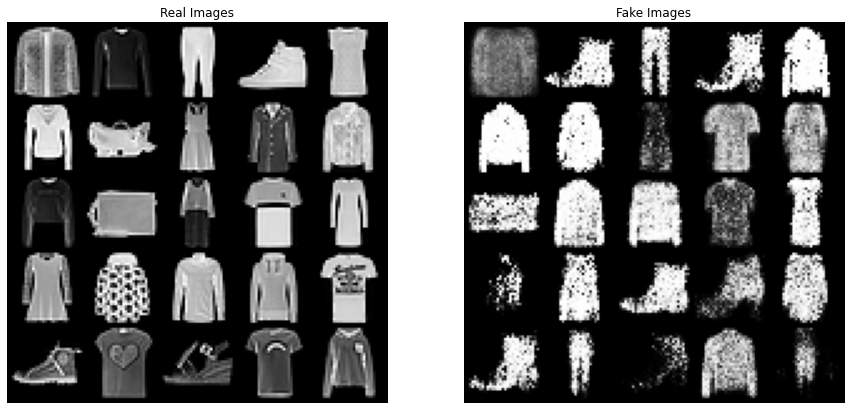

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 67/130] | [Step: 31500/60970], Generator Loss: 0.5208635192054014, Discriminator Loss: 0.4671098644224306
[Epoch: 67/130] | [Step: 31600/60970], Generator Loss: 0.5188484196551144, Discriminator Loss: 0.49850356904789805
[Epoch: 67/130] | [Step: 31700/60970], Generator Loss: 0.5159744280390441, Discriminator Loss: 0.47448031743988395
[Epoch: 67/130] | [Step: 31800/60970], Generator Loss: 0.49269745266065, Discriminator Loss: 0.5126277767121792


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 68/130] | [Step: 31900/60970], Generator Loss: 0.5399514882204433, Discriminator Loss: 0.525743074559917
[Epoch: 68/130] | [Step: 32000/60970], Generator Loss: 0.5170312141999602, Discriminator Loss: 0.47668654192239046
[Epoch: 68/130] | [Step: 32100/60970], Generator Loss: 0.5166070628911257, Discriminator Loss: 0.5099512804299593
[Epoch: 68/130] | [Step: 32200/60970], Generator Loss: 0.5145368687808514, Discriminator Loss: 0.47794832242652774
[Epoch: 68/130] | [Step: 32300/60970], Generator Loss: 0.5135543351061642, Discriminator Loss: 0.4801434432156384


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 69/130] | [Step: 32400/60970], Generator Loss: 0.5146479235651593, Discriminator Loss: 0.47198053697745007
[Epoch: 69/130] | [Step: 32500/60970], Generator Loss: 0.5183163229376078, Discriminator Loss: 0.507135393563658
[Epoch: 69/130] | [Step: 32600/60970], Generator Loss: 0.5266771800816059, Discriminator Loss: 0.5159487710334361
[Epoch: 69/130] | [Step: 32700/60970], Generator Loss: 0.5144945522770286, Discriminator Loss: 0.47436083061620593
[Epoch: 69/130] | [Step: 32800/60970], Generator Loss: 0.5073303706012666, Discriminator Loss: 0.4792173891328275


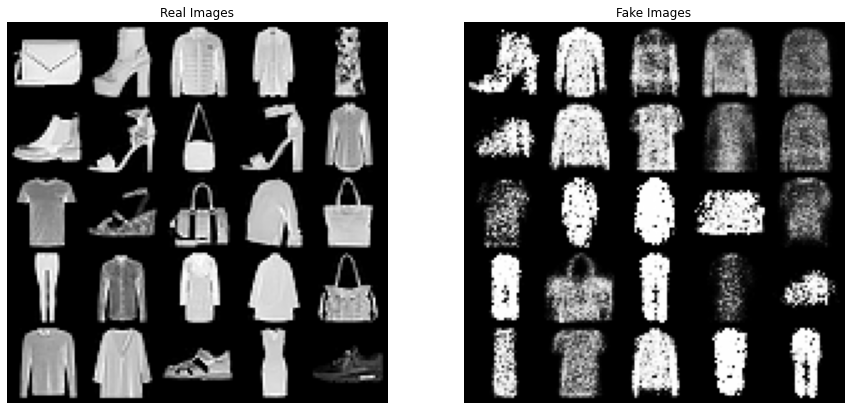

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 70/130] | [Step: 32900/60970], Generator Loss: 0.5198556987258295, Discriminator Loss: 0.47420347295701504
[Epoch: 70/130] | [Step: 33000/60970], Generator Loss: 0.5273667289875448, Discriminator Loss: 0.5100850504823029
[Epoch: 70/130] | [Step: 33100/60970], Generator Loss: 0.5295609044842422, Discriminator Loss: 0.5084118493832648
[Epoch: 70/130] | [Step: 33200/60970], Generator Loss: 0.5056811049580574, Discriminator Loss: 0.47837372450158


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 71/130] | [Step: 33300/60970], Generator Loss: 0.5210255409280459, Discriminator Loss: 0.5154447445335487
[Epoch: 71/130] | [Step: 33400/60970], Generator Loss: 0.5083278059028089, Discriminator Loss: 0.4868240519426763
[Epoch: 71/130] | [Step: 33500/60970], Generator Loss: 0.4985889378003776, Discriminator Loss: 0.5167961590923369
[Epoch: 71/130] | [Step: 33600/60970], Generator Loss: 0.510488192550838, Discriminator Loss: 0.47033237759023905
[Epoch: 71/130] | [Step: 33700/60970], Generator Loss: 0.5171280652284622, Discriminator Loss: 0.5231091026216745


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 72/130] | [Step: 33800/60970], Generator Loss: 0.5085001881234348, Discriminator Loss: 0.5131562113141019
[Epoch: 72/130] | [Step: 33900/60970], Generator Loss: 0.5133978356607258, Discriminator Loss: 0.47615615045651793
[Epoch: 72/130] | [Step: 34000/60970], Generator Loss: 0.5144207570701838, Discriminator Loss: 0.45717044407501817
[Epoch: 72/130] | [Step: 34100/60970], Generator Loss: 0.5172129231505096, Discriminator Loss: 0.4672091989777982
[Epoch: 72/130] | [Step: 34200/60970], Generator Loss: 0.5150542068295181, Discriminator Loss: 0.47279782220721245


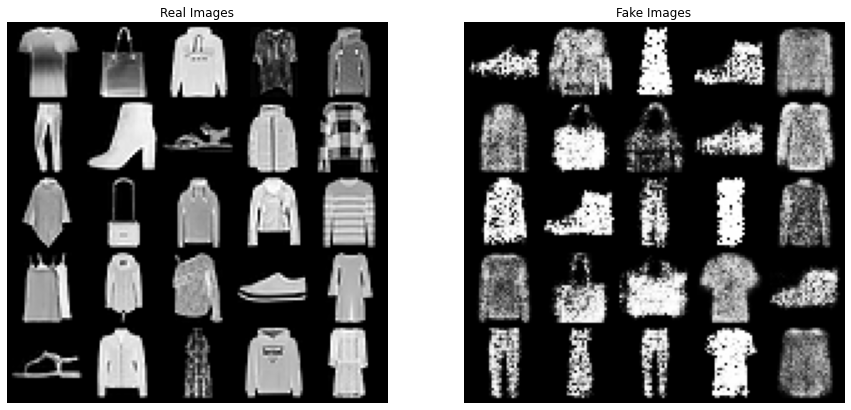

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 73/130] | [Step: 34300/60970], Generator Loss: 0.5140381317275265, Discriminator Loss: 0.46660370022679365
[Epoch: 73/130] | [Step: 34400/60970], Generator Loss: 0.5133918216452003, Discriminator Loss: 0.47714535100385547
[Epoch: 73/130] | [Step: 34500/60970], Generator Loss: 0.5134495329111814, Discriminator Loss: 0.47974875615909696
[Epoch: 73/130] | [Step: 34600/60970], Generator Loss: 0.5195996393449605, Discriminator Loss: 0.45486508030444384
[Epoch: 73/130] | [Step: 34700/60970], Generator Loss: 0.5163911934942007, Discriminator Loss: 0.47778006875887513


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 74/130] | [Step: 34800/60970], Generator Loss: 0.5076372486849625, Discriminator Loss: 0.49172152066603303
[Epoch: 74/130] | [Step: 34900/60970], Generator Loss: 0.5149636492133141, Discriminator Loss: 0.48203890258446336
[Epoch: 74/130] | [Step: 35000/60970], Generator Loss: 0.5228382484056056, Discriminator Loss: 0.490120992064476
[Epoch: 74/130] | [Step: 35100/60970], Generator Loss: 0.5140910265035927, Discriminator Loss: 0.4715286875143647


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 75/130] | [Step: 35200/60970], Generator Loss: 0.5091532031074166, Discriminator Loss: 0.4892279291525483
[Epoch: 75/130] | [Step: 35300/60970], Generator Loss: 0.5078025753609836, Discriminator Loss: 0.4901689039543271
[Epoch: 75/130] | [Step: 35400/60970], Generator Loss: 0.5136493570171297, Discriminator Loss: 0.4928969978354871
[Epoch: 75/130] | [Step: 35500/60970], Generator Loss: 0.5102902413345873, Discriminator Loss: 0.4879438974894583
[Epoch: 75/130] | [Step: 35600/60970], Generator Loss: 0.5071001364849508, Discriminator Loss: 0.49980963580310345


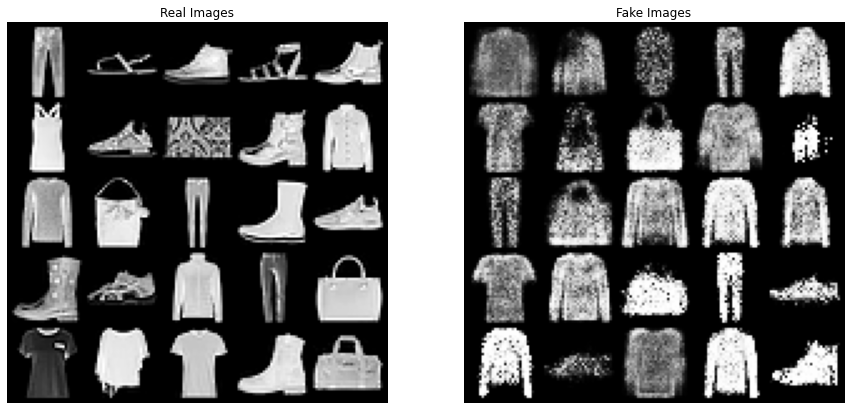

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 76/130] | [Step: 35700/60970], Generator Loss: 0.5053460104390979, Discriminator Loss: 0.5041044775086144
[Epoch: 76/130] | [Step: 35800/60970], Generator Loss: 0.5155944656580687, Discriminator Loss: 0.4691393687389791
[Epoch: 76/130] | [Step: 35900/60970], Generator Loss: 0.5259873867034912, Discriminator Loss: 0.511061648838222
[Epoch: 76/130] | [Step: 36000/60970], Generator Loss: 0.5327248829416931, Discriminator Loss: 0.5311144371517003
[Epoch: 76/130] | [Step: 36100/60970], Generator Loss: 0.5247414684854448, Discriminator Loss: 0.5174667914398015


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 77/130] | [Step: 36200/60970], Generator Loss: 0.5128137551558514, Discriminator Loss: 0.4843555075737337
[Epoch: 77/130] | [Step: 36300/60970], Generator Loss: 0.5094805830158293, Discriminator Loss: 0.4929780405946076
[Epoch: 77/130] | [Step: 36400/60970], Generator Loss: 0.5151777993887663, Discriminator Loss: 0.49386334884911776
[Epoch: 77/130] | [Step: 36500/60970], Generator Loss: 0.5133189614862204, Discriminator Loss: 0.5018956661224365


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 78/130] | [Step: 36600/60970], Generator Loss: 0.507226578425616, Discriminator Loss: 0.48939813223357004
[Epoch: 78/130] | [Step: 36700/60970], Generator Loss: 0.5106218466535211, Discriminator Loss: 0.47420303896069527
[Epoch: 78/130] | [Step: 36800/60970], Generator Loss: 0.515520665794611, Discriminator Loss: 0.4967105155810714
[Epoch: 78/130] | [Step: 36900/60970], Generator Loss: 0.5079682539217174, Discriminator Loss: 0.49177955696359277
[Epoch: 78/130] | [Step: 37000/60970], Generator Loss: 0.5177126941271126, Discriminator Loss: 0.48089682729914784


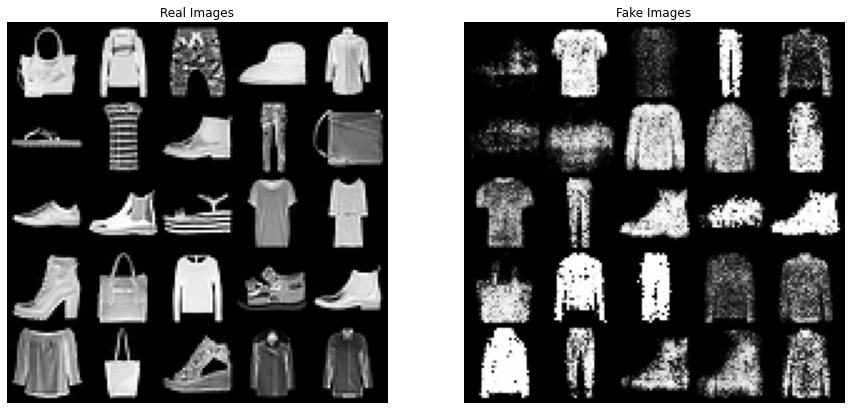

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 79/130] | [Step: 37100/60970], Generator Loss: 0.5163199974534411, Discriminator Loss: 0.4877340351231396
[Epoch: 79/130] | [Step: 37200/60970], Generator Loss: 0.512878596317023, Discriminator Loss: 0.5237824297510087
[Epoch: 79/130] | [Step: 37300/60970], Generator Loss: 0.5170889357104897, Discriminator Loss: 0.49605606822296977
[Epoch: 79/130] | [Step: 37400/60970], Generator Loss: 0.5128806573338807, Discriminator Loss: 0.48525611544027925
[Epoch: 79/130] | [Step: 37500/60970], Generator Loss: 0.5012448807246983, Discriminator Loss: 0.4994419920258224


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 80/130] | [Step: 37600/60970], Generator Loss: 0.5226571379850309, Discriminator Loss: 0.5114576291913788
[Epoch: 80/130] | [Step: 37700/60970], Generator Loss: 0.5311541091650724, Discriminator Loss: 0.5270266626030207
[Epoch: 80/130] | [Step: 37800/60970], Generator Loss: 0.5093539450317621, Discriminator Loss: 0.47717374423518777
[Epoch: 80/130] | [Step: 37900/60970], Generator Loss: 0.5082807233557105, Discriminator Loss: 0.4905593921430409


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 81/130] | [Step: 38000/60970], Generator Loss: 0.5212431829422712, Discriminator Loss: 0.46965552928547066
[Epoch: 81/130] | [Step: 38100/60970], Generator Loss: 0.5134744304232299, Discriminator Loss: 0.5028217784129083
[Epoch: 81/130] | [Step: 38200/60970], Generator Loss: 0.5086793028749526, Discriminator Loss: 0.5025454089045525
[Epoch: 81/130] | [Step: 38300/60970], Generator Loss: 0.5139845977537334, Discriminator Loss: 0.50262760091573
[Epoch: 81/130] | [Step: 38400/60970], Generator Loss: 0.5173365455120802, Discriminator Loss: 0.5055947047658265


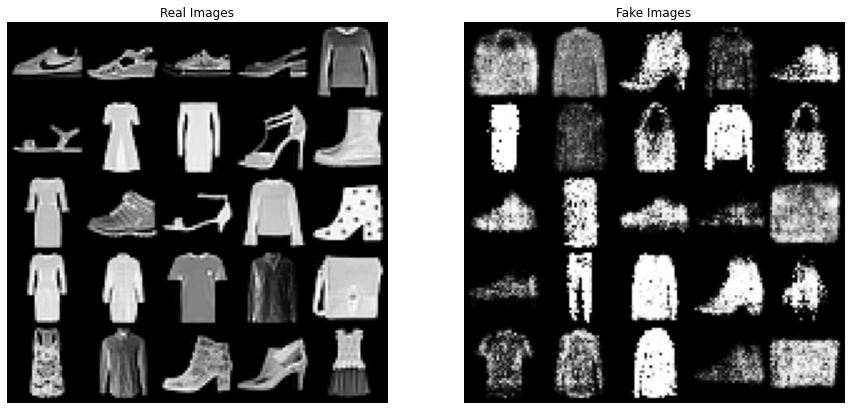

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 82/130] | [Step: 38500/60970], Generator Loss: 0.5143197250242035, Discriminator Loss: 0.4902642640906076
[Epoch: 82/130] | [Step: 38600/60970], Generator Loss: 0.4991823974996805, Discriminator Loss: 0.5219873269088566
[Epoch: 82/130] | [Step: 38700/60970], Generator Loss: 0.5169416209682822, Discriminator Loss: 0.4980828296393156
[Epoch: 82/130] | [Step: 38800/60970], Generator Loss: 0.5036293342709541, Discriminator Loss: 0.49079917604103684
[Epoch: 82/130] | [Step: 38900/60970], Generator Loss: 0.5149377146735787, Discriminator Loss: 0.4885994610376656


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 83/130] | [Step: 39000/60970], Generator Loss: 0.5145384254865348, Discriminator Loss: 0.5090528276438514
[Epoch: 83/130] | [Step: 39100/60970], Generator Loss: 0.5182899567298591, Discriminator Loss: 0.4995733415707946
[Epoch: 83/130] | [Step: 39200/60970], Generator Loss: 0.5125187369994819, Discriminator Loss: 0.4914440936408937
[Epoch: 83/130] | [Step: 39300/60970], Generator Loss: 0.5152467088773847, Discriminator Loss: 0.497999164275825


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 84/130] | [Step: 39400/60970], Generator Loss: 0.5188469666366775, Discriminator Loss: 0.509085622926553
[Epoch: 84/130] | [Step: 39500/60970], Generator Loss: 0.5110213016159832, Discriminator Loss: 0.5285843359306455
[Epoch: 84/130] | [Step: 39600/60970], Generator Loss: 0.5050013712607324, Discriminator Loss: 0.5075624524615705
[Epoch: 84/130] | [Step: 39700/60970], Generator Loss: 0.5091931778006256, Discriminator Loss: 0.488707491196692
[Epoch: 84/130] | [Step: 39800/60970], Generator Loss: 0.5163406375795603, Discriminator Loss: 0.48681082855910063


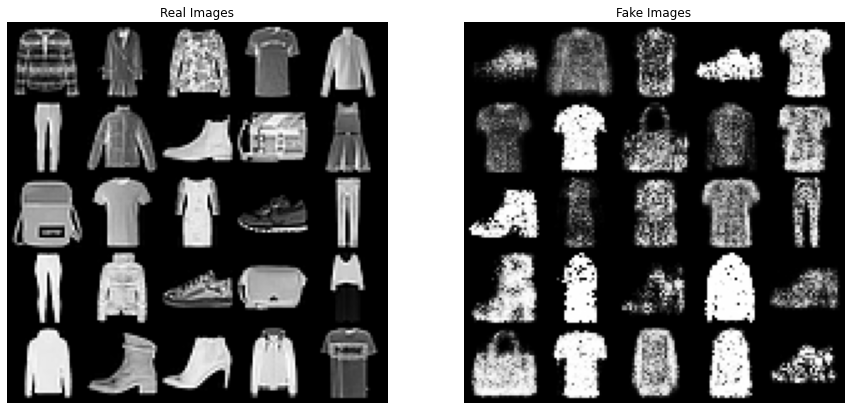

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 85/130] | [Step: 39900/60970], Generator Loss: 0.5305931712500751, Discriminator Loss: 0.5283770277164876
[Epoch: 85/130] | [Step: 40000/60970], Generator Loss: 0.5295149995945394, Discriminator Loss: 0.5233897748403251
[Epoch: 85/130] | [Step: 40100/60970], Generator Loss: 0.5293165817856789, Discriminator Loss: 0.5287803937681019
[Epoch: 85/130] | [Step: 40200/60970], Generator Loss: 0.5175077980384231, Discriminator Loss: 0.5153683167882264
[Epoch: 85/130] | [Step: 40300/60970], Generator Loss: 0.5022367667406797, Discriminator Loss: 0.4843174428679049


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 86/130] | [Step: 40400/60970], Generator Loss: 0.5296103750976423, Discriminator Loss: 0.5177020695991814
[Epoch: 86/130] | [Step: 40500/60970], Generator Loss: 0.522701917681843, Discriminator Loss: 0.5153517802245915
[Epoch: 86/130] | [Step: 40600/60970], Generator Loss: 0.5129499058239162, Discriminator Loss: 0.4881297298707068
[Epoch: 86/130] | [Step: 40700/60970], Generator Loss: 0.5138324606232345, Discriminator Loss: 0.5027250307612121
[Epoch: 86/130] | [Step: 40800/60970], Generator Loss: 0.5113207325339317, Discriminator Loss: 0.4960485831834376


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 87/130] | [Step: 40900/60970], Generator Loss: 0.521479891302685, Discriminator Loss: 0.510323784314096
[Epoch: 87/130] | [Step: 41000/60970], Generator Loss: 0.5118864318355918, Discriminator Loss: 0.5111388969235122
[Epoch: 87/130] | [Step: 41100/60970], Generator Loss: 0.5126453335396945, Discriminator Loss: 0.5008718678727746
[Epoch: 87/130] | [Step: 41200/60970], Generator Loss: 0.5048982566222548, Discriminator Loss: 0.5000115348957479


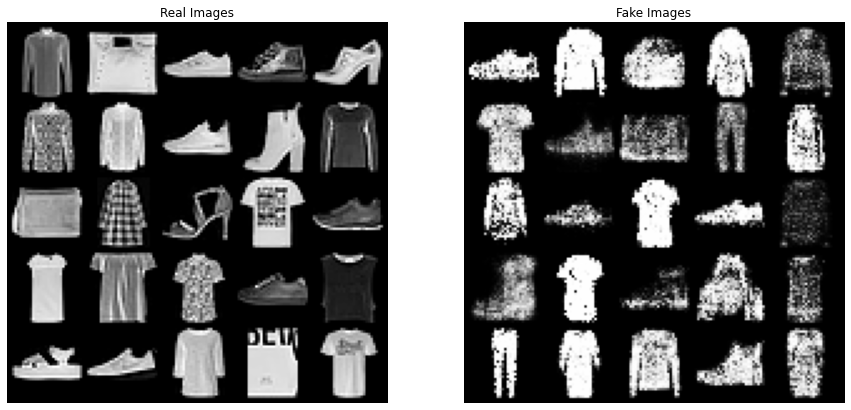

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 88/130] | [Step: 41300/60970], Generator Loss: 0.5220529592285554, Discriminator Loss: 0.5133808590471745
[Epoch: 88/130] | [Step: 41400/60970], Generator Loss: 0.5118587361648679, Discriminator Loss: 0.4764964380301535
[Epoch: 88/130] | [Step: 41500/60970], Generator Loss: 0.5044928113929927, Discriminator Loss: 0.50026237918064
[Epoch: 88/130] | [Step: 41600/60970], Generator Loss: 0.5161137385293841, Discriminator Loss: 0.5048812502063811
[Epoch: 88/130] | [Step: 41700/60970], Generator Loss: 0.5150540214963257, Discriminator Loss: 0.49082066863775253


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 89/130] | [Step: 41800/60970], Generator Loss: 0.5153601703544458, Discriminator Loss: 0.4925067420117557
[Epoch: 89/130] | [Step: 41900/60970], Generator Loss: 0.5191265908069909, Discriminator Loss: 0.5023718089796603
[Epoch: 89/130] | [Step: 42000/60970], Generator Loss: 0.5159963453188539, Discriminator Loss: 0.5244033490307629
[Epoch: 89/130] | [Step: 42100/60970], Generator Loss: 0.5142436930909753, Discriminator Loss: 0.5127589236944914
[Epoch: 89/130] | [Step: 42200/60970], Generator Loss: 0.5098115489818156, Discriminator Loss: 0.4891186919994652


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 90/130] | [Step: 42300/60970], Generator Loss: 0.5198343661613762, Discriminator Loss: 0.5098203012409309
[Epoch: 90/130] | [Step: 42400/60970], Generator Loss: 0.5261744777671993, Discriminator Loss: 0.5211360473185778
[Epoch: 90/130] | [Step: 42500/60970], Generator Loss: 0.5093692350201309, Discriminator Loss: 0.4895868110470474
[Epoch: 90/130] | [Step: 42600/60970], Generator Loss: 0.5220389850437641, Discriminator Loss: 0.5086697773076594


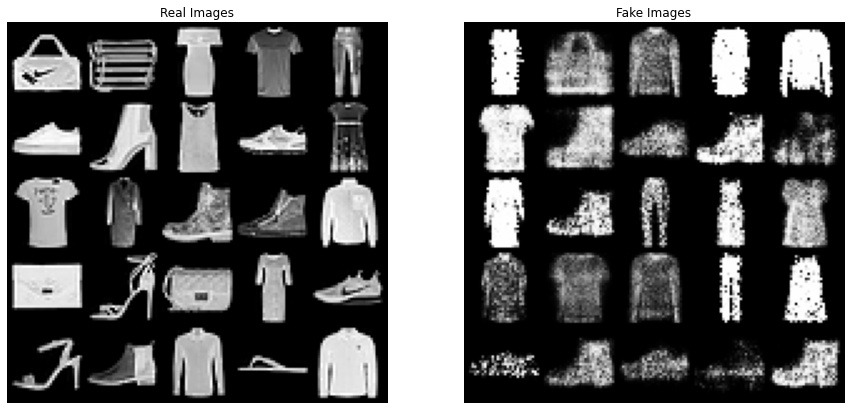

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 91/130] | [Step: 42700/60970], Generator Loss: 0.5214659419531624, Discriminator Loss: 0.5205264257577558
[Epoch: 91/130] | [Step: 42800/60970], Generator Loss: 0.510929255746305, Discriminator Loss: 0.5071823517791927
[Epoch: 91/130] | [Step: 42900/60970], Generator Loss: 0.5125210033729672, Discriminator Loss: 0.497465159278363
[Epoch: 91/130] | [Step: 43000/60970], Generator Loss: 0.5220881565473974, Discriminator Loss: 0.5236263442784548
[Epoch: 91/130] | [Step: 43100/60970], Generator Loss: 0.5110927228815854, Discriminator Loss: 0.5115154408849776


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 92/130] | [Step: 43200/60970], Generator Loss: 0.5188689463150998, Discriminator Loss: 0.5235048638035854
[Epoch: 92/130] | [Step: 43300/60970], Generator Loss: 0.5035360348410904, Discriminator Loss: 0.49253508960828185
[Epoch: 92/130] | [Step: 43400/60970], Generator Loss: 0.5080509106628597, Discriminator Loss: 0.4914193730801344
[Epoch: 92/130] | [Step: 43500/60970], Generator Loss: 0.5138948843814433, Discriminator Loss: 0.49888090742751956
[Epoch: 92/130] | [Step: 43600/60970], Generator Loss: 0.5105579728260636, Discriminator Loss: 0.48372075241059065


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 93/130] | [Step: 43700/60970], Generator Loss: 0.5180804075983663, Discriminator Loss: 0.5396605371497571
[Epoch: 93/130] | [Step: 43800/60970], Generator Loss: 0.52823590580374, Discriminator Loss: 0.5253678243607283
[Epoch: 93/130] | [Step: 43900/60970], Generator Loss: 0.5080405012704432, Discriminator Loss: 0.49808408692479134
[Epoch: 93/130] | [Step: 44000/60970], Generator Loss: 0.5164803727529943, Discriminator Loss: 0.5140431388281286


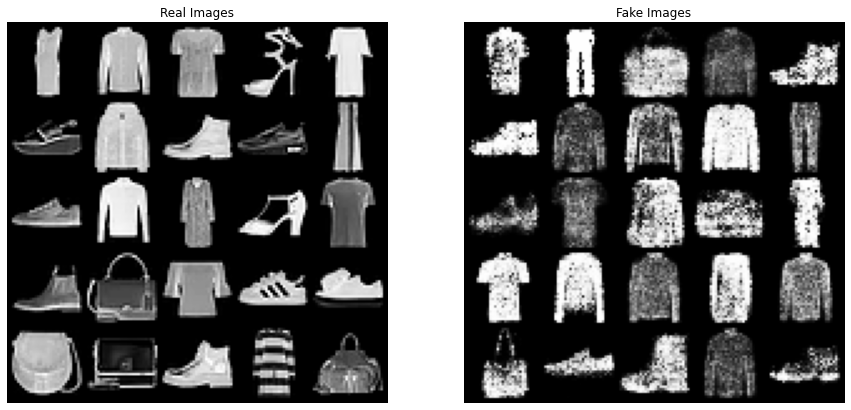

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 94/130] | [Step: 44100/60970], Generator Loss: 0.519225765640537, Discriminator Loss: 0.5092855837816994
[Epoch: 94/130] | [Step: 44200/60970], Generator Loss: 0.5251471353694797, Discriminator Loss: 0.5214993027038872
[Epoch: 94/130] | [Step: 44300/60970], Generator Loss: 0.5130918561480939, Discriminator Loss: 0.5154621442779899
[Epoch: 94/130] | [Step: 44400/60970], Generator Loss: 0.523973363917321, Discriminator Loss: 0.5287398998625576
[Epoch: 94/130] | [Step: 44500/60970], Generator Loss: 0.517921781167388, Discriminator Loss: 0.5288680382072926


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 95/130] | [Step: 44600/60970], Generator Loss: 0.5235527842305601, Discriminator Loss: 0.5270295813679695
[Epoch: 95/130] | [Step: 44700/60970], Generator Loss: 0.5088225174695253, Discriminator Loss: 0.4970895298756659
[Epoch: 95/130] | [Step: 44800/60970], Generator Loss: 0.5215814360417426, Discriminator Loss: 0.5184978116303682
[Epoch: 95/130] | [Step: 44900/60970], Generator Loss: 0.5304437782615423, Discriminator Loss: 0.5368315330706537
[Epoch: 95/130] | [Step: 45000/60970], Generator Loss: 0.522309772670269, Discriminator Loss: 0.5287861172109842


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 96/130] | [Step: 45100/60970], Generator Loss: 0.5137080637117226, Discriminator Loss: 0.5070438782374065
[Epoch: 96/130] | [Step: 45200/60970], Generator Loss: 0.5152428424917161, Discriminator Loss: 0.5041076275520027
[Epoch: 96/130] | [Step: 45300/60970], Generator Loss: 0.5125052342191339, Discriminator Loss: 0.49948606826364994
[Epoch: 96/130] | [Step: 45400/60970], Generator Loss: 0.504994269926101, Discriminator Loss: 0.5163498339243233


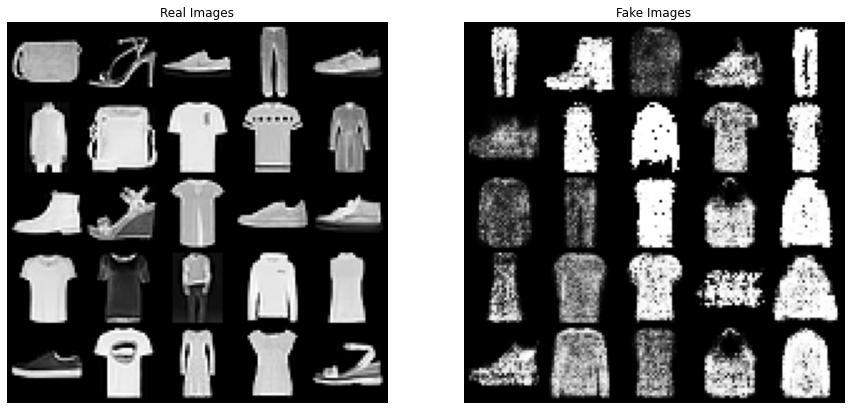

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 97/130] | [Step: 45500/60970], Generator Loss: 0.503904012652735, Discriminator Loss: 0.5161880526381235
[Epoch: 97/130] | [Step: 45600/60970], Generator Loss: 0.5414464329369366, Discriminator Loss: 0.5412212982773781
[Epoch: 97/130] | [Step: 45700/60970], Generator Loss: 0.5409201877191663, Discriminator Loss: 0.5405029174871743
[Epoch: 97/130] | [Step: 45800/60970], Generator Loss: 0.5279786949977279, Discriminator Loss: 0.529360365588218
[Epoch: 97/130] | [Step: 45900/60970], Generator Loss: 0.5109287137165666, Discriminator Loss: 0.4958401503972709


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 98/130] | [Step: 46000/60970], Generator Loss: 0.5113195781596005, Discriminator Loss: 0.505949229778101
[Epoch: 98/130] | [Step: 46100/60970], Generator Loss: 0.5073777991347015, Discriminator Loss: 0.5043838419951499
[Epoch: 98/130] | [Step: 46200/60970], Generator Loss: 0.5158423539251089, Discriminator Loss: 0.5103803756646812
[Epoch: 98/130] | [Step: 46300/60970], Generator Loss: 0.5009327684529126, Discriminator Loss: 0.4923143582418561
[Epoch: 98/130] | [Step: 46400/60970], Generator Loss: 0.510809326544404, Discriminator Loss: 0.49403660790994763


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 99/130] | [Step: 46500/60970], Generator Loss: 0.5267575043253601, Discriminator Loss: 0.5272392917734882
[Epoch: 99/130] | [Step: 46600/60970], Generator Loss: 0.5338968774303794, Discriminator Loss: 0.5251728827133775
[Epoch: 99/130] | [Step: 46700/60970], Generator Loss: 0.5174489272758365, Discriminator Loss: 0.5046196500770748
[Epoch: 99/130] | [Step: 46800/60970], Generator Loss: 0.512040174100548, Discriminator Loss: 0.5168981458991766


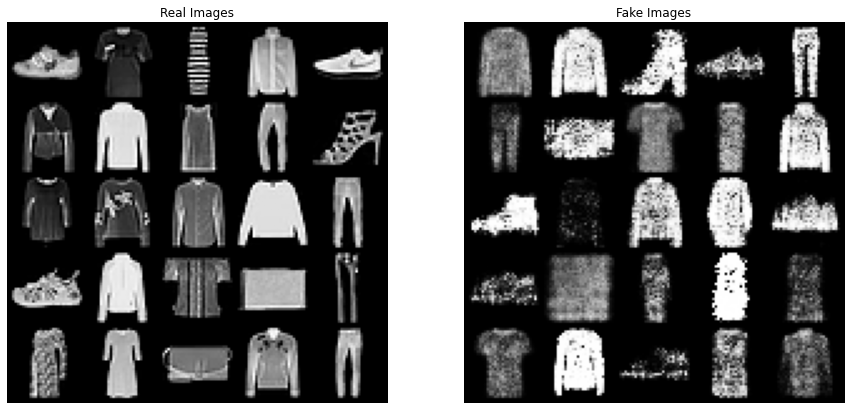

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 100/130] | [Step: 46900/60970], Generator Loss: 0.5075357421301305, Discriminator Loss: 0.4984967553367217
[Epoch: 100/130] | [Step: 47000/60970], Generator Loss: 0.505278489086777, Discriminator Loss: 0.49711535638198256
[Epoch: 100/130] | [Step: 47100/60970], Generator Loss: 0.5228367964737117, Discriminator Loss: 0.5199396568350494
[Epoch: 100/130] | [Step: 47200/60970], Generator Loss: 0.529951867647469, Discriminator Loss: 0.5263258935883641
[Epoch: 100/130] | [Step: 47300/60970], Generator Loss: 0.5092046852223575, Discriminator Loss: 0.5020458423532546


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 101/130] | [Step: 47400/60970], Generator Loss: 0.5268850174422066, Discriminator Loss: 0.5180783290416002
[Epoch: 101/130] | [Step: 47500/60970], Generator Loss: 0.5102350837551057, Discriminator Loss: 0.49819239089265466
[Epoch: 101/130] | [Step: 47600/60970], Generator Loss: 0.519167535007, Discriminator Loss: 0.5067597408778965
[Epoch: 101/130] | [Step: 47700/60970], Generator Loss: 0.5102697354741395, Discriminator Loss: 0.5035782367922366
[Epoch: 101/130] | [Step: 47800/60970], Generator Loss: 0.5119292954914272, Discriminator Loss: 0.49280977016314864


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 102/130] | [Step: 47900/60970], Generator Loss: 0.5149657926522195, Discriminator Loss: 0.5038084358287355
[Epoch: 102/130] | [Step: 48000/60970], Generator Loss: 0.5245694136247039, Discriminator Loss: 0.5276487045921385
[Epoch: 102/130] | [Step: 48100/60970], Generator Loss: 0.5312324911355972, Discriminator Loss: 0.5354797397740185
[Epoch: 102/130] | [Step: 48200/60970], Generator Loss: 0.5312169608660042, Discriminator Loss: 0.5354264960624278
[Epoch: 102/130] | [Step: 48300/60970], Generator Loss: 0.5123493880964816, Discriminator Loss: 0.49521554773673415


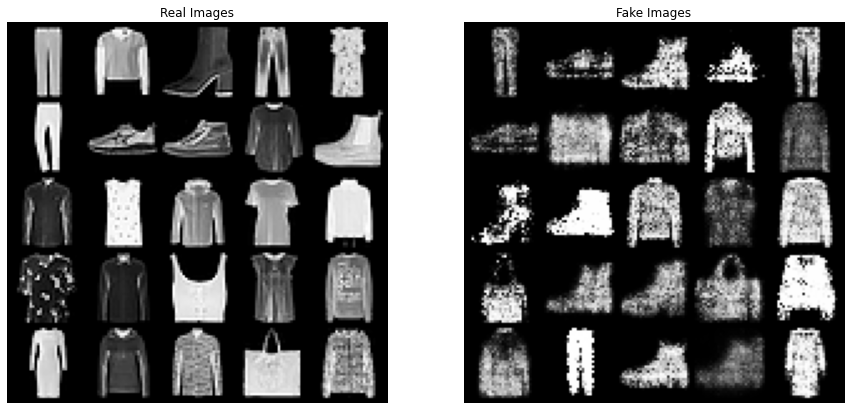

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 103/130] | [Step: 48400/60970], Generator Loss: 0.5188907479556898, Discriminator Loss: 0.5182539070956409
[Epoch: 103/130] | [Step: 48500/60970], Generator Loss: 0.5215566763654351, Discriminator Loss: 0.5346527900546789
[Epoch: 103/130] | [Step: 48600/60970], Generator Loss: 0.5349487089551985, Discriminator Loss: 0.533034180290997
[Epoch: 103/130] | [Step: 48700/60970], Generator Loss: 0.5171724525280297, Discriminator Loss: 0.5132698225788772


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 104/130] | [Step: 48800/60970], Generator Loss: 0.5071529677758615, Discriminator Loss: 0.4988330154058834
[Epoch: 104/130] | [Step: 48900/60970], Generator Loss: 0.5095379580743611, Discriminator Loss: 0.5078773079439998
[Epoch: 104/130] | [Step: 49000/60970], Generator Loss: 0.5152760790660977, Discriminator Loss: 0.513545345980674
[Epoch: 104/130] | [Step: 49100/60970], Generator Loss: 0.5141275469213724, Discriminator Loss: 0.49723996873945
[Epoch: 104/130] | [Step: 49200/60970], Generator Loss: 0.5118494816124439, Discriminator Loss: 0.5054668826051056


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 105/130] | [Step: 49300/60970], Generator Loss: 0.5099397300121685, Discriminator Loss: 0.49389549546564615
[Epoch: 105/130] | [Step: 49400/60970], Generator Loss: 0.5175225106067955, Discriminator Loss: 0.5213811290450394
[Epoch: 105/130] | [Step: 49500/60970], Generator Loss: 0.515572885517031, Discriminator Loss: 0.5026843817904592
[Epoch: 105/130] | [Step: 49600/60970], Generator Loss: 0.5235999207943678, Discriminator Loss: 0.5212936392053962
[Epoch: 105/130] | [Step: 49700/60970], Generator Loss: 0.5277778659947217, Discriminator Loss: 0.5366636430844665


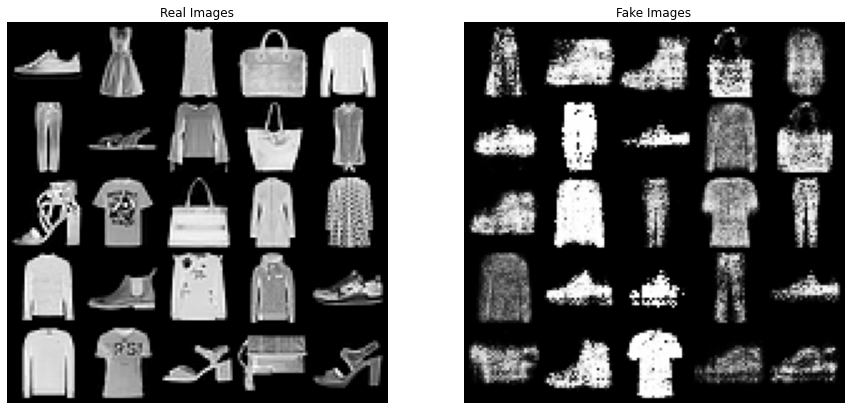

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 106/130] | [Step: 49800/60970], Generator Loss: 0.5229700445197523, Discriminator Loss: 0.513254583037148
[Epoch: 106/130] | [Step: 49900/60970], Generator Loss: 0.5227918792515993, Discriminator Loss: 0.5143721578642726
[Epoch: 106/130] | [Step: 50000/60970], Generator Loss: 0.517515636049211, Discriminator Loss: 0.518842177465558
[Epoch: 106/130] | [Step: 50100/60970], Generator Loss: 0.5115805510431528, Discriminator Loss: 0.508064984343946


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 107/130] | [Step: 50200/60970], Generator Loss: 0.5131099768914282, Discriminator Loss: 0.5221071640650432
[Epoch: 107/130] | [Step: 50300/60970], Generator Loss: 0.5185186504386365, Discriminator Loss: 0.5156975006684661
[Epoch: 107/130] | [Step: 50400/60970], Generator Loss: 0.5132464445196092, Discriminator Loss: 0.5059961616061628
[Epoch: 107/130] | [Step: 50500/60970], Generator Loss: 0.5143608818762004, Discriminator Loss: 0.4974837452173233
[Epoch: 107/130] | [Step: 50600/60970], Generator Loss: 0.5048713432624936, Discriminator Loss: 0.5016462625935674


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 108/130] | [Step: 50700/60970], Generator Loss: 0.5211793606479962, Discriminator Loss: 0.5329848501520853
[Epoch: 108/130] | [Step: 50800/60970], Generator Loss: 0.5306736724451184, Discriminator Loss: 0.5308539890684187
[Epoch: 108/130] | [Step: 50900/60970], Generator Loss: 0.5125769819132984, Discriminator Loss: 0.48272313410416245
[Epoch: 108/130] | [Step: 51000/60970], Generator Loss: 0.5234318664297462, Discriminator Loss: 0.5289375865831971
[Epoch: 108/130] | [Step: 51100/60970], Generator Loss: 0.5332221644930542, Discriminator Loss: 0.5279102702625096


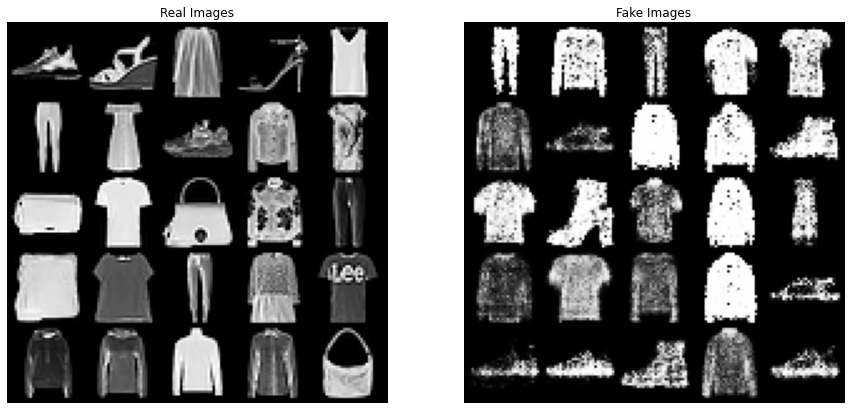

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 109/130] | [Step: 51200/60970], Generator Loss: 0.5288858525454998, Discriminator Loss: 0.5298542535553377
[Epoch: 109/130] | [Step: 51300/60970], Generator Loss: 0.5204210942611098, Discriminator Loss: 0.5184599789790809
[Epoch: 109/130] | [Step: 51400/60970], Generator Loss: 0.5149017265066504, Discriminator Loss: 0.5038048019632697
[Epoch: 109/130] | [Step: 51500/60970], Generator Loss: 0.5253954753279686, Discriminator Loss: 0.5206555859185755


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 110/130] | [Step: 51600/60970], Generator Loss: 0.5244063943003614, Discriminator Loss: 0.5299258292652667
[Epoch: 110/130] | [Step: 51700/60970], Generator Loss: 0.516355587169528, Discriminator Loss: 0.5156836924143136
[Epoch: 110/130] | [Step: 51800/60970], Generator Loss: 0.510527906473726, Discriminator Loss: 0.5024370816536248
[Epoch: 110/130] | [Step: 51900/60970], Generator Loss: 0.5285647413693368, Discriminator Loss: 0.5364580666646361
[Epoch: 110/130] | [Step: 52000/60970], Generator Loss: 0.5128532429225743, Discriminator Loss: 0.5028424365445971


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 111/130] | [Step: 52100/60970], Generator Loss: 0.5255295519406598, Discriminator Loss: 0.5339874777322013
[Epoch: 111/130] | [Step: 52200/60970], Generator Loss: 0.5408152639865875, Discriminator Loss: 0.5409310818649828
[Epoch: 111/130] | [Step: 52300/60970], Generator Loss: 0.5412408844567835, Discriminator Loss: 0.5407887757755816
[Epoch: 111/130] | [Step: 52400/60970], Generator Loss: 0.5412772023119032, Discriminator Loss: 0.5410394151695073
[Epoch: 111/130] | [Step: 52500/60970], Generator Loss: 0.5414116098545492, Discriminator Loss: 0.5408554701134562


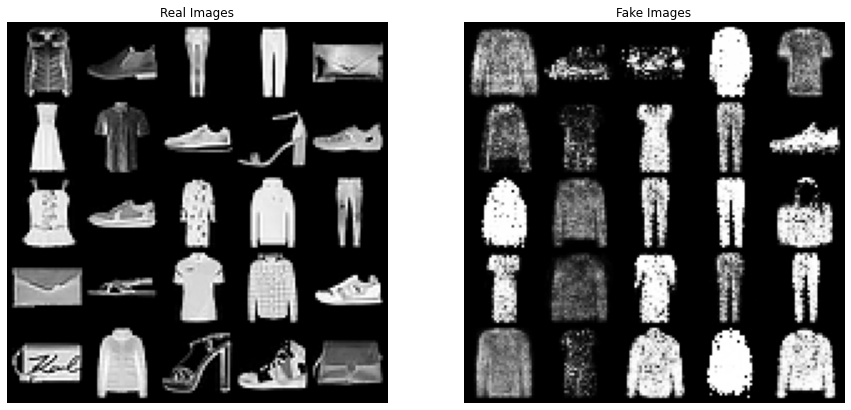

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 112/130] | [Step: 52600/60970], Generator Loss: 0.5431755003519356, Discriminator Loss: 0.5425167108575503
[Epoch: 112/130] | [Step: 52700/60970], Generator Loss: 0.5413760454393923, Discriminator Loss: 0.5405623326078057
[Epoch: 112/130] | [Step: 52800/60970], Generator Loss: 0.5407993951812387, Discriminator Loss: 0.5404094862751663
[Epoch: 112/130] | [Step: 52900/60970], Generator Loss: 0.5407121488824487, Discriminator Loss: 0.5404539960436523


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 113/130] | [Step: 53000/60970], Generator Loss: 0.5429144441150129, Discriminator Loss: 0.5423024779496094
[Epoch: 113/130] | [Step: 53100/60970], Generator Loss: 0.5400853916071355, Discriminator Loss: 0.5390833071433008
[Epoch: 113/130] | [Step: 53200/60970], Generator Loss: 0.5354689019732177, Discriminator Loss: 0.5360284140333533
[Epoch: 113/130] | [Step: 53300/60970], Generator Loss: 0.5290320115163922, Discriminator Loss: 0.5321400770917535
[Epoch: 113/130] | [Step: 53400/60970], Generator Loss: 0.5298531698063016, Discriminator Loss: 0.5306340814568102


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 114/130] | [Step: 53500/60970], Generator Loss: 0.5369440942692261, Discriminator Loss: 0.5386602614695828
[Epoch: 114/130] | [Step: 53600/60970], Generator Loss: 0.5322840875014663, Discriminator Loss: 0.5322254355996847
[Epoch: 114/130] | [Step: 53700/60970], Generator Loss: 0.5263763112016022, Discriminator Loss: 0.5314616854302585
[Epoch: 114/130] | [Step: 53800/60970], Generator Loss: 0.5267943274229765, Discriminator Loss: 0.5282887425273657
[Epoch: 114/130] | [Step: 53900/60970], Generator Loss: 0.5255052079446614, Discriminator Loss: 0.5127281690947711


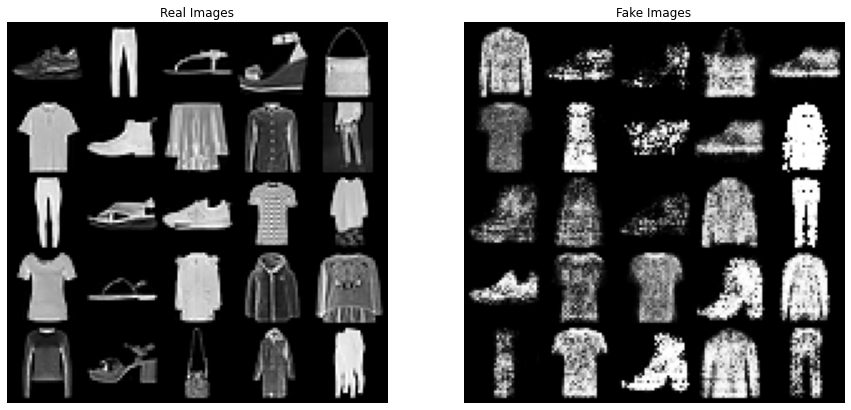

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 115/130] | [Step: 54000/60970], Generator Loss: 0.5082254457908372, Discriminator Loss: 0.5048943557776511
[Epoch: 115/130] | [Step: 54100/60970], Generator Loss: 0.5219949511811137, Discriminator Loss: 0.5144610367715359
[Epoch: 115/130] | [Step: 54200/60970], Generator Loss: 0.5024415636435151, Discriminator Loss: 0.5105231935158372
[Epoch: 115/130] | [Step: 54300/60970], Generator Loss: 0.5188195244409144, Discriminator Loss: 0.5039640860632062
[Epoch: 115/130] | [Step: 54400/60970], Generator Loss: 0.5103410356678069, Discriminator Loss: 0.4724562643095851


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 116/130] | [Step: 54500/60970], Generator Loss: 0.515305374128123, Discriminator Loss: 0.5198274787204962
[Epoch: 116/130] | [Step: 54600/60970], Generator Loss: 0.5084022930823267, Discriminator Loss: 0.5053646247833967
[Epoch: 116/130] | [Step: 54700/60970], Generator Loss: 0.5198316317982972, Discriminator Loss: 0.5088335960172117
[Epoch: 116/130] | [Step: 54800/60970], Generator Loss: 0.5268925139680505, Discriminator Loss: 0.5247573726810515


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 117/130] | [Step: 54900/60970], Generator Loss: 0.5071232258342206, Discriminator Loss: 0.5005472715323169
[Epoch: 117/130] | [Step: 55000/60970], Generator Loss: 0.513827633112669, Discriminator Loss: 0.5067516337148845
[Epoch: 117/130] | [Step: 55100/60970], Generator Loss: 0.5056212414056063, Discriminator Loss: 0.5092522292397916
[Epoch: 117/130] | [Step: 55200/60970], Generator Loss: 0.5117589039728045, Discriminator Loss: 0.4931277986615896
[Epoch: 117/130] | [Step: 55300/60970], Generator Loss: 0.5142350336536765, Discriminator Loss: 0.48197490628808737


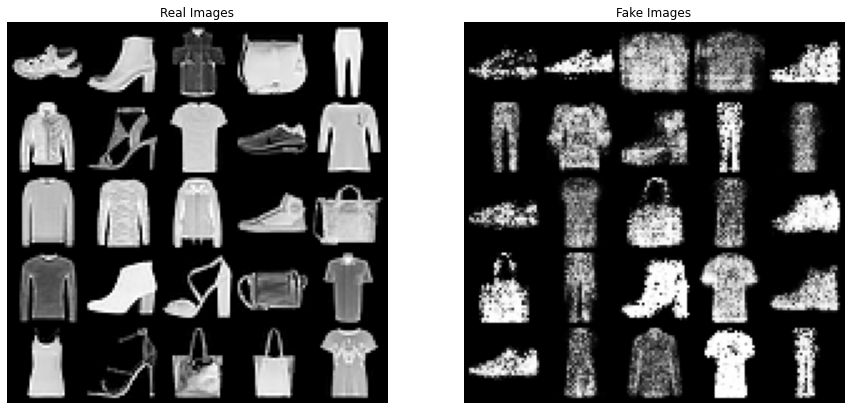

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 118/130] | [Step: 55400/60970], Generator Loss: 0.5294100261914233, Discriminator Loss: 0.5263289616753658
[Epoch: 118/130] | [Step: 55500/60970], Generator Loss: 0.5377995376475155, Discriminator Loss: 0.5328734302893281
[Epoch: 118/130] | [Step: 55600/60970], Generator Loss: 0.5361934159882367, Discriminator Loss: 0.5329687879420817
[Epoch: 118/130] | [Step: 55700/60970], Generator Loss: 0.5319657316431403, Discriminator Loss: 0.5277946987189353
[Epoch: 118/130] | [Step: 55800/60970], Generator Loss: 0.5318265073001385, Discriminator Loss: 0.5282505871728063


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 119/130] | [Step: 55900/60970], Generator Loss: 0.5184834958054125, Discriminator Loss: 0.5257902159355581
[Epoch: 119/130] | [Step: 56000/60970], Generator Loss: 0.515015353448689, Discriminator Loss: 0.5223949449136853
[Epoch: 119/130] | [Step: 56100/60970], Generator Loss: 0.5295426589436829, Discriminator Loss: 0.5189913781359792
[Epoch: 119/130] | [Step: 56200/60970], Generator Loss: 0.5173866981640458, Discriminator Loss: 0.5160414385609329


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 120/130] | [Step: 56300/60970], Generator Loss: 0.5197012981710334, Discriminator Loss: 0.5209885314106941
[Epoch: 120/130] | [Step: 56400/60970], Generator Loss: 0.5150665245018899, Discriminator Loss: 0.5001823394559324
[Epoch: 120/130] | [Step: 56500/60970], Generator Loss: 0.5158491036854684, Discriminator Loss: 0.5365387923084199
[Epoch: 120/130] | [Step: 56600/60970], Generator Loss: 0.5382523383013904, Discriminator Loss: 0.5403755730949342
[Epoch: 120/130] | [Step: 56700/60970], Generator Loss: 0.5413812757469714, Discriminator Loss: 0.5396572868339717


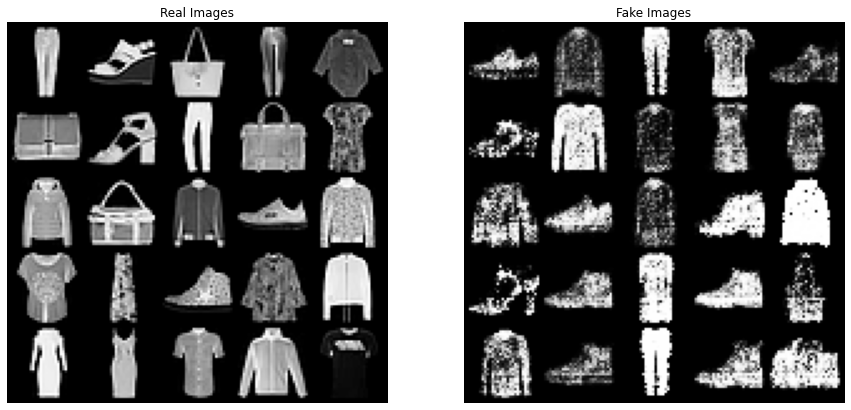

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 121/130] | [Step: 56800/60970], Generator Loss: 0.5355276699798803, Discriminator Loss: 0.5403250401529174
[Epoch: 121/130] | [Step: 56900/60970], Generator Loss: 0.5329975835047662, Discriminator Loss: 0.5353285218589008
[Epoch: 121/130] | [Step: 57000/60970], Generator Loss: 0.5281180338934064, Discriminator Loss: 0.5336285079829395
[Epoch: 121/130] | [Step: 57100/60970], Generator Loss: 0.5174512933008373, Discriminator Loss: 0.5231633628718555
[Epoch: 121/130] | [Step: 57200/60970], Generator Loss: 0.5046363240107894, Discriminator Loss: 0.5201825401745737


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 122/130] | [Step: 57300/60970], Generator Loss: 0.5245477819504838, Discriminator Loss: 0.5339829342750211
[Epoch: 122/130] | [Step: 57400/60970], Generator Loss: 0.5316655617207289, Discriminator Loss: 0.5392508371733129
[Epoch: 122/130] | [Step: 57500/60970], Generator Loss: 0.5351240513846278, Discriminator Loss: 0.5402052281424403
[Epoch: 122/130] | [Step: 57600/60970], Generator Loss: 0.5370649956166744, Discriminator Loss: 0.5380926756188273


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 123/130] | [Step: 57700/60970], Generator Loss: 0.5130014629103243, Discriminator Loss: 0.515332877015074
[Epoch: 123/130] | [Step: 57800/60970], Generator Loss: 0.5205595046281815, Discriminator Loss: 0.523861019872129
[Epoch: 123/130] | [Step: 57900/60970], Generator Loss: 0.5302602048031986, Discriminator Loss: 0.5349213816225529
[Epoch: 123/130] | [Step: 58000/60970], Generator Loss: 0.5379623915068805, Discriminator Loss: 0.5372224873863161
[Epoch: 123/130] | [Step: 58100/60970], Generator Loss: 0.5364471613429487, Discriminator Loss: 0.539803633466363


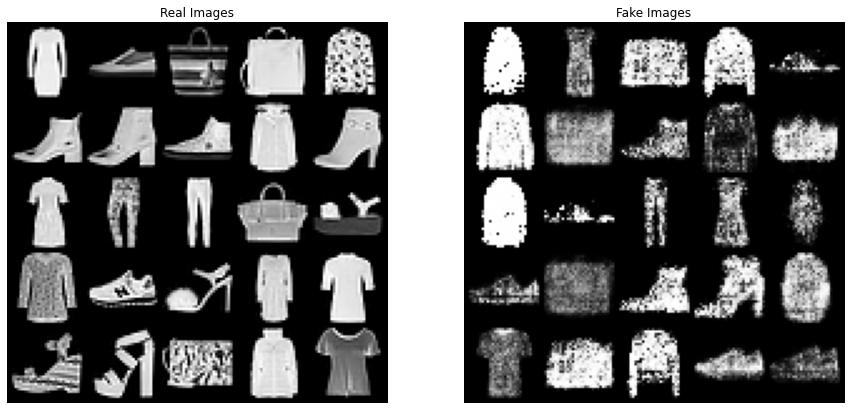

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 124/130] | [Step: 58200/60970], Generator Loss: 0.5415759463794529, Discriminator Loss: 0.5425534912695487
[Epoch: 124/130] | [Step: 58300/60970], Generator Loss: 0.5376533400267363, Discriminator Loss: 0.5373852592892945
[Epoch: 124/130] | [Step: 58400/60970], Generator Loss: 0.5251161982305348, Discriminator Loss: 0.527246808167547
[Epoch: 124/130] | [Step: 58500/60970], Generator Loss: 0.5331747336313128, Discriminator Loss: 0.5301986886188388
[Epoch: 124/130] | [Step: 58600/60970], Generator Loss: 0.5372735424898565, Discriminator Loss: 0.5389007888734341


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 125/130] | [Step: 58700/60970], Generator Loss: 0.5390345056851705, Discriminator Loss: 0.5402247870030502
[Epoch: 125/130] | [Step: 58800/60970], Generator Loss: 0.525541964918375, Discriminator Loss: 0.5263436776585877
[Epoch: 125/130] | [Step: 58900/60970], Generator Loss: 0.5144948954693973, Discriminator Loss: 0.5202829255722463
[Epoch: 125/130] | [Step: 59000/60970], Generator Loss: 0.5294775199145079, Discriminator Loss: 0.5286883939988911


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 126/130] | [Step: 59100/60970], Generator Loss: 0.5344846933148801, Discriminator Loss: 0.5403398992493749
[Epoch: 126/130] | [Step: 59200/60970], Generator Loss: 0.502545528113842, Discriminator Loss: 0.5188070917502046
[Epoch: 126/130] | [Step: 59300/60970], Generator Loss: 0.5172949866391718, Discriminator Loss: 0.5270748897455633
[Epoch: 126/130] | [Step: 59400/60970], Generator Loss: 0.5324778123758733, Discriminator Loss: 0.5356107903644443
[Epoch: 126/130] | [Step: 59500/60970], Generator Loss: 0.5325418254360557, Discriminator Loss: 0.5377802597358823


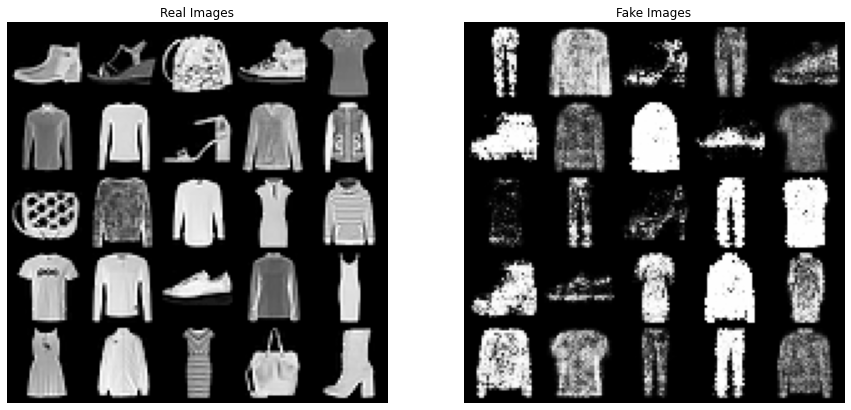

  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 127/130] | [Step: 59600/60970], Generator Loss: 0.5314432491237919, Discriminator Loss: 0.541338303592056
[Epoch: 127/130] | [Step: 59700/60970], Generator Loss: 0.5279344455339015, Discriminator Loss: 0.5342940161935985
[Epoch: 127/130] | [Step: 59800/60970], Generator Loss: 0.5335447345860302, Discriminator Loss: 0.5353074008598924
[Epoch: 127/130] | [Step: 59900/60970], Generator Loss: 0.5143394307233393, Discriminator Loss: 0.5292302831076086
[Epoch: 127/130] | [Step: 60000/60970], Generator Loss: 0.531055046711117, Discriminator Loss: 0.5397058753296733


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 128/130] | [Step: 60100/60970], Generator Loss: 0.5285147082371017, Discriminator Loss: 0.5375759008650979
[Epoch: 128/130] | [Step: 60200/60970], Generator Loss: 0.5134770455770195, Discriminator Loss: 0.5259465575218201
[Epoch: 128/130] | [Step: 60300/60970], Generator Loss: 0.5270746247842908, Discriminator Loss: 0.5191205460578203
[Epoch: 128/130] | [Step: 60400/60970], Generator Loss: 0.5074036158621311, Discriminator Loss: 0.5015964605845511
[Epoch: 128/130] | [Step: 60500/60970], Generator Loss: 0.5154899368062615, Discriminator Loss: 0.5039023980498314


  0%|          | 0/469 [00:00<?, ?it/s]

[Epoch: 129/130] | [Step: 60600/60970], Generator Loss: 0.522004721686244, Discriminator Loss: 0.5279223541729152
[Epoch: 129/130] | [Step: 60700/60970], Generator Loss: 0.5221760985441506, Discriminator Loss: 0.5079756285995245
[Epoch: 129/130] | [Step: 60800/60970], Generator Loss: 0.5316057167947292, Discriminator Loss: 0.5399438831955194
[Epoch: 129/130] | [Step: 60900/60970], Generator Loss: 0.5364586478099227, Discriminator Loss: 0.5401792982593179


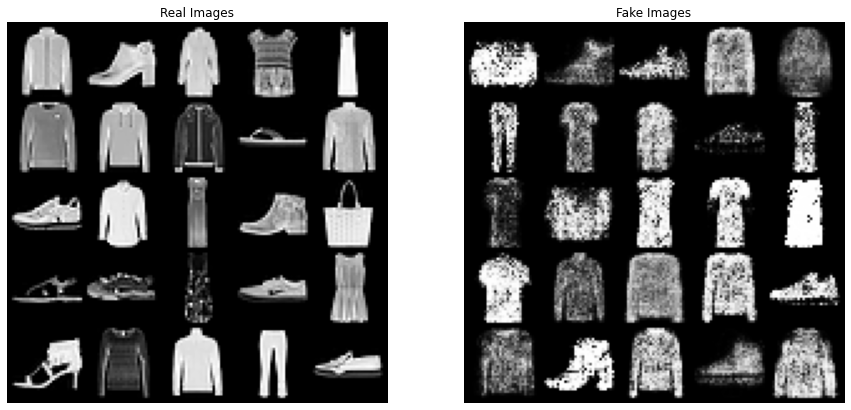

In [ ]:
# Training Loop

img_list = []
G_losses = []
D_losses = []

iters = 0
cur_step = 0
img_show = 3

mean_generator_loss = 0
mean_discriminator_loss = 0

for epoch in range(num_epochs):

  for real_images, _ in tqdm(train_loader):
    cur_batch_size = len(real_images)

    real_images = real_images.view(cur_batch_size, -1).to(device)

    disc_optimizer.zero_grad()
    true_labels = _.to(device)
    disc_loss = get_discriminator_loss(generator, discriminator, criterion, real_images, cur_batch_size, noise_dim, true_labels, device)
    disc_loss.backward()
    disc_optimizer.step()


    gen_optimizer.zero_grad()
    fake_labels = torch.randint(0, 10, (cur_batch_size,)).to(device)
    gen_loss = get_generator_loss(generator, discriminator, criterion, cur_batch_size, noise_dim, fake_labels, device)
    gen_loss.backward()
    gen_optimizer.step()

    mean_discriminator_loss += disc_loss.item() / cur_batch_size
    mean_generator_loss += gen_loss.item() / cur_batch_size

    G_losses.append(mean_discriminator_loss)
    D_losses.append(mean_generator_loss)


    if cur_step % display_step == 0 and cur_step >= 0:
      print(f"[Epoch: {epoch}/{num_epochs}] | [Step: {cur_step}/{num_epochs*len(train_loader)}], Generator Loss: {mean_generator_loss}, Discriminator Loss: {mean_discriminator_loss}")
      fake_noise = get_generator_noise(cur_batch_size, noise_dim, device=device)
      fake = generator(fake_noise, fake_labels)

      img_list.append(make_grid(fake.detach().cpu().view(-1, *image_size)[:36], nrow=6, normalize=True, padding=2))
      mean_discriminator_loss = 0
      mean_generator_loss = 0

    cur_step += 1

  if epoch % img_show == 0:
    fake_noise = get_generator_noise(cur_batch_size, noise_dim, device=device)
    fake = generator(fake_noise, fake_labels)
    show_tensor_images(real_images, fake)

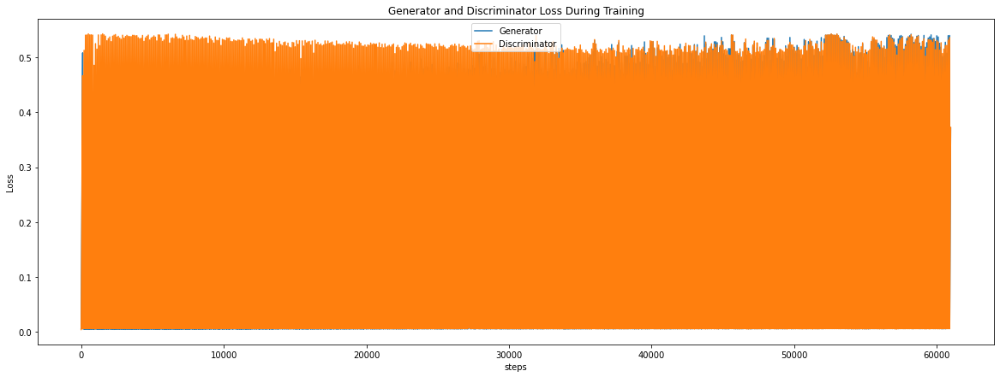

In [ ]:
plt.figure(figsize=(20, 7))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses, label="Generator")
plt.plot(D_losses, label="Discriminator")
plt.xlabel("steps")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21025789 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


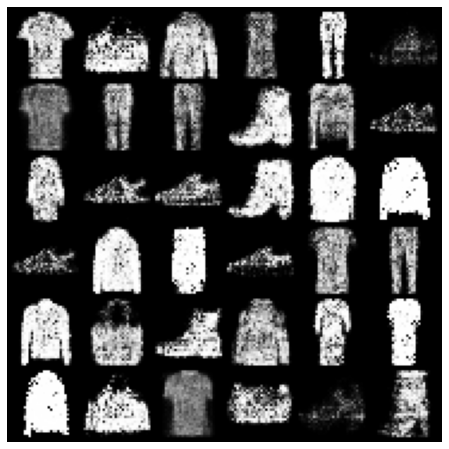

In [ ]:
fig = plt.figure(figsize=(8, 8))
plt.axis("off")
imgs = [[plt.imshow(np.transpose(img, (1,2,0)), animated=True)] for img in img_list]
anim = animation.ArtistAnimation(fig, imgs, interval=100, repeat_delay=1000, blit=True)

HTML(anim.to_jshtml())

In [ ]:
fake_labels = torch.randint(0, 10, (10,)).to(device)

In [ ]:
noise = get_generator_noise(10, noise_dim, device=device)
gen = generator(noise, fake_labels)

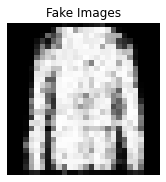

In [ ]:
  image_unflat_fake = fake.detach().cpu().view(-1, *image_size)
  image_grid_fake = make_grid(image_unflat_fake[:1], nrow=5, normalize=True, padding=2)
  plt.imshow(image_grid_fake.permute(1, 2, 0).squeeze())
  plt.show()